In [4]:
#!/bin/bash
!curl -L -o human-faces-object-detection.zip https://www.kaggle.com/api/v1/datasets/download/sbaghbidi/human-faces-object-detection

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100  498M  100  498M    0     0  63.1M      0  0:00:07  0:00:07 --:--:-- 48.7M


In [5]:
# unzip the file
!unzip human-faces-object-detection.zip

Archive:  human-faces-object-detection.zip
  inflating: faces.csv               
  inflating: images/00000003.jpg     
  inflating: images/00000004.jpg     
  inflating: images/00000005.jpg     
  inflating: images/00000006.jpg     
  inflating: images/00000008.jpg     
  inflating: images/00000011.jpg     
  inflating: images/00000012.jpg     
  inflating: images/00000015.jpg     
  inflating: images/00000018.jpg     
  inflating: images/00000020.jpg     
  inflating: images/00000022.jpg     
  inflating: images/00000023.jpg     
  inflating: images/00000024.jpg     
  inflating: images/00000026.jpg     
  inflating: images/00000031.jpg     
  inflating: images/00000032.jpg     
  inflating: images/00000041.jpg     
  inflating: images/00000044.jpg     
  inflating: images/00000045.jpg     
  inflating: images/00000047.jpg     
  inflating: images/00000050.jpg     
  inflating: images/00000051.jpg     
  inflating: images/00000055.jpg     
  inflating: images/00000058.jpg     
  infla

In [98]:
import numpy as np
import pandas as pd
import os
import cv2
import copy
import shutil

In [35]:
bs=' '
class_id=0
newline='\n'
extension='.txt'

In [8]:
df = pd.read_csv('/content/faces.csv')
df.head()

,image_name,width,height,x0,y0,x1,y1
0,00001722.jpg,1333,2000,490,320,687,664
1,00001044.jpg,2000,1333,791,119,1200,436
2,00001050.jpg,667,1000,304,155,407,331
3,00001736.jpg,626,417,147,14,519,303
4,00003121.jpg,626,418,462,60,599,166


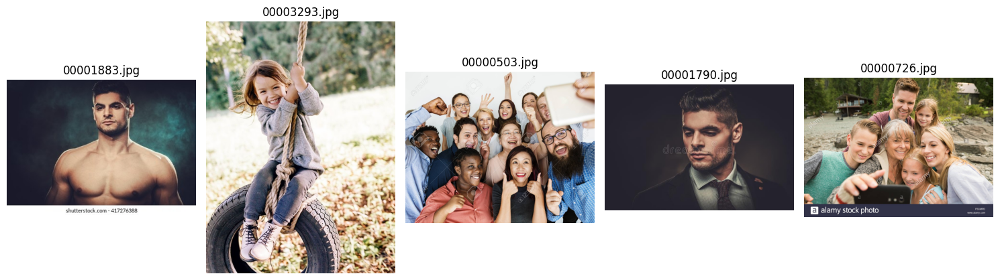

In [9]:
import matplotlib.pyplot as plt
from PIL import Image

image_dir = '/content/images'

sample_images = df['image_name'].sample(5).tolist()

# Display the sample images
plt.figure(figsize=(15, 5))
for i, img_name in enumerate(sample_images):
    img_path = os.path.join(image_dir, img_name)
    img = Image.open(img_path)
    plt.subplot(1, 5, i + 1)
    plt.imshow(img)
    plt.title(img_name)
    plt.axis('off')

plt.tight_layout()
plt.show()

In [10]:
df.shape

(3350, 7)

In [11]:
df.columns

Index(['image_name', 'width', 'height', 'x0', 'y0', 'x1', 'y1'], dtype='object')

In [12]:
curr_path = os.getcwd()
print(curr_path)

/content


In [13]:
img_train_path = os.path.join(curr_path,'images','train')
img_val_path = os.path.join(curr_path,'images','val')
img_test_path = os.path.join(curr_path,'images','test')

label_train_path = os.path.join(curr_path,'labels','train')
label_val_path = os.path.join(curr_path,'labels','val')
label_test_path = os.path.join(curr_path,'labels','test')

In [74]:
data_path = '/content'
label_path = os.path.join(curr_path,'face_labels')

In [39]:
os.makedirs(label_path)

In [40]:
os.listdir(data_path)

['faces.csv', 'face_labels', 'images']

In [24]:
all_items = os.listdir(data_path)

for item in all_items:
    item_path = os.path.join(data_path, item)
    if item not in ['faces.csv', 'images']:
        if os.path.isfile(item_path):
            os.remove(item_path)
        elif os.path.isdir(item_path):
            !rm -r {item_path}

print(os.listdir(data_path))

['faces.csv', 'images']


In [58]:
img_path = os.path.join(data_path,'images')
raw_annonation_path = os.path.join(data_path,'faces.csv')

In [42]:
face_list = os.listdir(img_path)
face_list[:10]

['00001888.jpg',
 '00002639.jpg',
 '00000842.jpg',
 '00001900.jpg',
 '00001647.jpg',
 '00001409.jpg',
 '00001499.jpg',
 '00000939.jpg',
 '00001962.jpg',
 '00001686.jpg']

In [43]:
import random
random.shuffle(face_list)

In [44]:
face_list[:10]

['00002120.jpg',
 '00001275.jpg',
 '00000194.jpg',
 '00000917.jpg',
 '00001252.jpg',
 '00002111.jpg',
 '00002891.jpg',
 '00003390.jpg',
 '00000824.jpg',
 '00003459.jpg']

In [45]:
len(face_list)

2204

In [46]:
train_split = 0.8
val_split = 0.1
test_split = 0.1

train_size = int(len(face_list) * train_split)
val_size = int(len(face_list) * val_split)
test_size = int(len(face_list) * test_split)

In [47]:
img_train_list = face_list[:train_size]
img_val_list = face_list[train_size:train_size+val_size]
img_test_list = face_list[train_size+val_size:]

In [48]:
len(img_train_list), len(img_val_list), len(img_test_list)

(1763, 220, 221)

In [53]:
def change_extension(file):
  basename=os.path.splitext(file)[0]
  filename=basename+extension
  return filename

In [56]:
label_train_list = list(map(change_extension, img_train_list))
label_val_list = list(map(change_extension, img_val_list))
label_test_list = list(map(change_extension, img_test_list))

In [57]:
label_test_list[:5]

['00001491.txt',
 '00001974.txt',
 '00000837.txt',
 '00003150.txt',
 '00001032.txt']

In [66]:
raw_annotations=pd.read_csv(raw_annonation_path)
raw_annotations

,image_name,width,height,x0,y0,x1,y1
0,00001722.jpg,1333,2000,490,320,687,664
1,00001044.jpg,2000,1333,791,119,1200,436
2,00001050.jpg,667,1000,304,155,407,331
3,00001736.jpg,626,417,147,14,519,303
4,00003121.jpg,626,418,462,60,599,166
...,...,...,...,...,...,...,...
3345,00002232.jpg,620,349,4,36,186,158
3346,00002232.jpg,620,349,122,103,344,248
3347,00002232.jpg,620,349,258,118,541,303
3348,00002232.jpg,620,349,215,11,362,108


In [67]:
raw_annotations['x_center'] = 0.5*(raw_annotations['x0']+raw_annotations['x1'])
raw_annotations['y_center'] = 0.5*(raw_annotations['y0']+raw_annotations['y1'])
raw_annotations['bb_width'] = raw_annotations['x1']-raw_annotations['x0']
raw_annotations['bb_height'] = raw_annotations['y1']-raw_annotations['y0']

In [68]:
raw_annotations

,image_name,width,height,x0,y0,x1,y1,x_center,y_center,bb_width,bb_height
0,00001722.jpg,1333,2000,490,320,687,664,588.5,492.0,197,344
1,00001044.jpg,2000,1333,791,119,1200,436,995.5,277.5,409,317
2,00001050.jpg,667,1000,304,155,407,331,355.5,243.0,103,176
3,00001736.jpg,626,417,147,14,519,303,333.0,158.5,372,289
4,00003121.jpg,626,418,462,60,599,166,530.5,113.0,137,106
...,...,...,...,...,...,...,...,...,...,...,...
3345,00002232.jpg,620,349,4,36,186,158,95.0,97.0,182,122
3346,00002232.jpg,620,349,122,103,344,248,233.0,175.5,222,145
3347,00002232.jpg,620,349,258,118,541,303,399.5,210.5,283,185
3348,00002232.jpg,620,349,215,11,362,108,288.5,59.5,147,97


In [70]:
raw_annotations['x_center_scaled'] = raw_annotations['x_center']/raw_annotations['width']
raw_annotations['y_center_scaled'] = raw_annotations['y_center']/raw_annotations['height']
raw_annotations['width_scaled'] = raw_annotations['bb_width']/raw_annotations['width']
raw_annotations['height_scaled'] = raw_annotations['bb_height']/raw_annotations['height']

In [71]:
raw_annotations

,image_name,width,height,x0,y0,x1,y1,x_center,y_center,bb_width,bb_height,x_center_scaled,y_center_scaled,width_scaled,height_scaled
0,00001722.jpg,1333,2000,490,320,687,664,588.5,492.0,197,344,0.441485,0.246000,0.147787,0.172000
1,00001044.jpg,2000,1333,791,119,1200,436,995.5,277.5,409,317,0.497750,0.208177,0.204500,0.237809
2,00001050.jpg,667,1000,304,155,407,331,355.5,243.0,103,176,0.532984,0.243000,0.154423,0.176000
3,00001736.jpg,626,417,147,14,519,303,333.0,158.5,372,289,0.531949,0.380096,0.594249,0.693046
4,00003121.jpg,626,418,462,60,599,166,530.5,113.0,137,106,0.847444,0.270335,0.218850,0.253589
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3345,00002232.jpg,620,349,4,36,186,158,95.0,97.0,182,122,0.153226,0.277937,0.293548,0.349570
3346,00002232.jpg,620,349,122,103,344,248,233.0,175.5,222,145,0.375806,0.502865,0.358065,0.415473
3347,00002232.jpg,620,349,258,118,541,303,399.5,210.5,283,185,0.644355,0.603152,0.456452,0.530086
3348,00002232.jpg,620,349,215,11,362,108,288.5,59.5,147,97,0.465323,0.170487,0.237097,0.277937


In [75]:
imgs=raw_annotations.groupby('image_name')

In [76]:
len(imgs)

2204

In [79]:
for image in imgs:
    img_df=imgs.get_group(image[0])
    basename=os.path.splitext(image[0])[0]
    txt_file=basename+extension
    filepath=os.path.join(label_path, txt_file)
    lines=[]
    i=1
    for index,row in img_df.iterrows():
        if i!=len(img_df):
            line=str(class_id)+bs+str(row['x_center_scaled'])+bs+str(row['y_center_scaled'])+bs+str(row['width_scaled'])+bs+str(row['height_scaled'])+newline
            lines.append(line)
        else:
            line=str(class_id)+bs+str(row['x_center_scaled'])+bs+str(row['y_center_scaled'])+bs+str(row['width_scaled'])+bs+ str(row['height_scaled'])
            lines.append(line)
        i=i+1
    with open(filepath, 'w') as file:
        file.writelines(lines)

In [80]:
os.listdir(label_path)[:5]

['00002650.txt',
 '00001944.txt',
 '00002841.txt',
 '00002628.txt',
 '00001210.txt']

In [82]:
# random file
random_file = os.path.join(label_path, os.listdir(label_path)[4])
with open(random_file, 'r')as f:
  content = f.read()
content

'0 0.5011111111111111 0.16333333333333333 0.2288888888888889 0.26666666666666666'

In [83]:
def_size = 640

In [85]:
# function to move file
def move_file(data_list, source_path, destination_path):
    i=0
    for file in data_list:
        filepath=os.path.join(source_path, file)
        dest_path=os.path.join(data_path, destination_path)
        if not os.path.isdir(dest_path):
            os.makedirs(dest_path)
        shutil.move(filepath, dest_path)
        i=i+1
    print("Number of files transferred:", i)

In [87]:
# function to move images
def move_images(data_list, source_path, destination_path):
    i=0
    for file in data_list:
        filepath=os.path.join(source_path, file)
        dest_path=os.path.join(data_path, destination_path)

        if not os.path.isdir(dest_path):
            os.makedirs(dest_path)
        finalimage_path=os.path.join(dest_path, file)
        img_resized=cv2.resize(cv2.imread(filepath), (def_size, def_size))
        cv2.imwrite(finalimage_path, img_resized)
        i=i+1
    print("Number of files transferred:", i)

In [88]:
move_images(img_train_list, img_path, img_train_path)
move_images(img_val_list, img_path, img_val_path)
move_images(img_test_list, img_path, img_test_path)

Number of files transferred: 1763
Number of files transferred: 220
Number of files transferred: 221


In [90]:
move_file(label_train_list, label_path, label_train_path)
move_file(label_val_list, label_path, label_val_path)
move_file(label_test_list, label_path, label_test_path)

Number of files transferred: 1763
Number of files transferred: 220
Number of files transferred: 221


#### what does shutil.rmtree(labels_path) do?

In the provided code, `shutil.rmtree(labels_path)` is used to **recursively remove a directory tree**.

Specifically, `shutil.rmtree()` will:

1.  Remove the directory specified by the path stored in the `labels_path` variable.
2.  Remove all subdirectories within `labels_path`.
3.  Remove all files within `labels_path` and its subdirectories.

In the context of your code, `labels_path` was created earlier using `os.makedirs(label_path)` and was used to store the generated YOLO format label files. After the label files have been moved to the `train`, `val`, and `test` subdirectories within the `labels` folder, the original `face_labels` directory (pointed to by `labels_path`) is no longer needed and is removed using `shutil.rmtree`.

In [92]:
shutil.rmtree(label_path)

In [110]:
ln_1 = '# Train/val/test sets'+ newline
ln_2 = 'train: '+ "'"+img_train_path+"'" + newline
ln_3 = 'val: '+ "'"+img_val_path+"'" + newline
ln_4 = 'test: '+ "'"+img_test_path+"'" + newline
ln_5 = newline
ln_6 = "# Classes" + newline
ln_7 = 'names: ["face"]' + newline
config_lines = [ln_1, ln_2, ln_3, ln_4, ln_5, ln_6, ln_7]

In [111]:
config_path = os.path.join(curr_path, 'config.yaml')
config_path

'/content/config.yaml'

In [112]:
with open(config_path, 'w') as file:
    file.writelines(config_lines)

In [113]:
def get_bbox_from_label(text_file_path):
    bbox_list=[]
    with open(text_file_path, "r") as file:
        for line in file:
            _,x_centre,y_centre,width,height=line.strip().split(" ")
            x1=(float(x_centre)+(float(width)/2))*def_size
            x0=(float(x_centre)-(float(width)/2))*def_size
            y1=(float(y_centre)+(float(height)/2))*def_size
            y0=(float(y_centre)-(float(height)/2))*def_size

            vertices=np.array([[int(x0), int(y0)], [int(x1), int(y0)],
                               [int(x1),int(y1)], [int(x0),int(y1)]])
            bbox_list.append(vertices)

    return tuple(bbox_list)

In [114]:
red = (0, 0, 255)

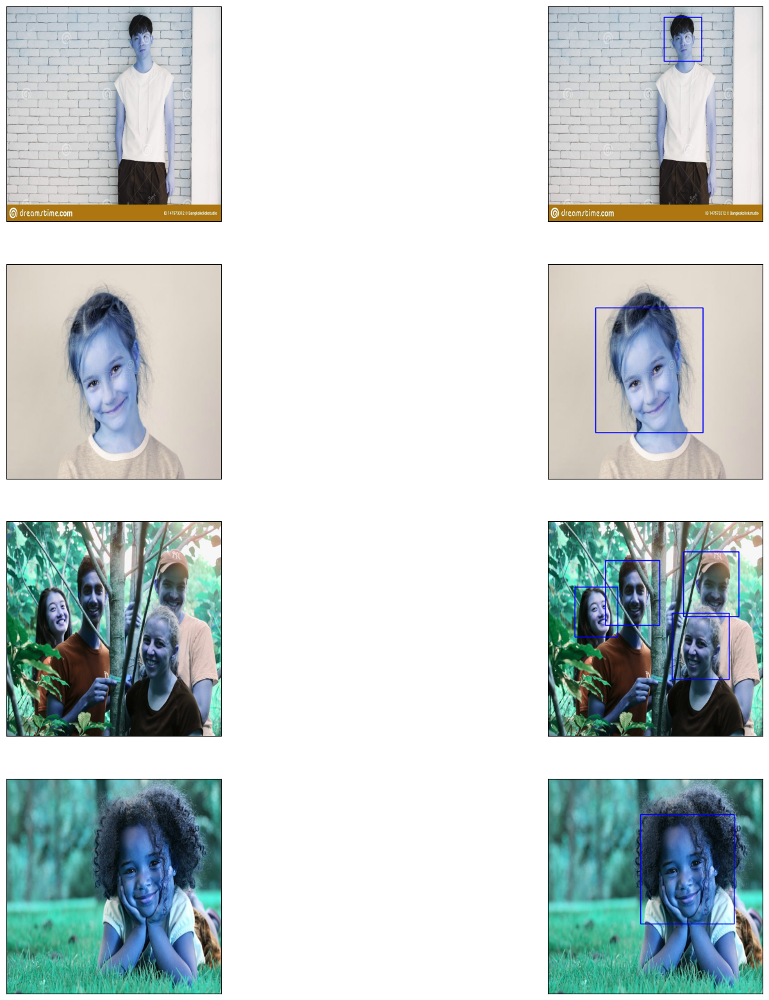

In [115]:
plt.figure(figsize=(20,20))
for i in range(1,8,2):
    k=random.randint(0, len(img_train_list)-1)
    img_path=os.path.join(img_train_path, img_train_list[k])
    label_path=os.path.join(label_train_path, label_train_list[k])
    bbox=get_bbox_from_label(label_path)
    image=cv2.imread(img_path)
    image_copy=copy.deepcopy(image)
    ax=plt.subplot(4, 2, i)
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])
    cv2.drawContours(image_copy, bbox, -1,red, 2)
    ax=plt.subplot(4, 2, i+1)
    plt.imshow(image_copy)
    plt.xticks([])
    plt.yticks([])

In [103]:
!pip install ultralytics
from ultralytics import YOLO

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 27.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 65.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 36.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 51.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 100.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling

In [108]:
model=YOLO('yolov8n.yaml').load('yolov8s.pt')

100%|██████████| 21.5M/21.5M [00:00<00:00, 246MB/s]

Transferred 95/355 items from pretrained weights


In [116]:
results=model.train(data=config_path, epochs=20, resume=True, iou=0.5, conf=0.001)

Ultralytics 8.3.153 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=0.001, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/config.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=20, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.5, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.yaml, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=yol


train: Scanning /content/labels/train.cache... 1763 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1763/1763 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 456.7±105.1 MB/s, size: 78.6 KB)



val: Scanning /content/labels/val.cache... 220 images, 0 backgrounds, 0 corrupt: 100%|██████████| 220/220 [00:00<?, ?it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
       1/20      2.04G      2.906      5.016      2.717         32        640:   0%|          | 0/111 [00:00<?, ?it/s]
       1/20      2.04G      2.906      5.016      2.717         32        640:   1%|          | 1/111 [00:00<00:28,  3.86it/s]
       1/20      2.04G      2.787      4.285      2.728         54        640:   1%|          | 1/111 [00:00<00:28,  3.86it/s]
       1/20      2.04G      2.787      4.285      2.728         54        640:   2%|▏         | 2/111 [00:00<00:30,  3.58it/s]
       1/20      2.04G      2.789      4.288       2.73         33        640:   2%|▏         | 2/111 [00:00<00:30,  3.58it/s]
       1/20      2.04G      2.789      4.288       2.73         33        640:   3%|▎         | 3/111 [00:01<00:38,  2.81it/s]
       1/20      2.04G      2.781      4.137      2.695         56        640:   3%|▎         | 3/111 [00:01<00:38,  2.81it/s]
       1/20      2.04G      2.781      4.137      2.695         56        640:

                   all        220        306      0.121      0.301     0.0768     0.0229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
       2/20      2.54G      2.235      3.012      2.114         48        640:   0%|          | 0/111 [00:00<?, ?it/s]
       2/20      2.54G      2.235      3.012      2.114         48        640:   1%|          | 1/111 [00:00<00:27,  3.97it/s]
       2/20      2.54G      2.232      3.052      2.135         58        640:   1%|          | 1/111 [00:00<00:27,  3.97it/s]
       2/20      2.54G      2.232      3.052      2.135         58        640:   2%|▏         | 2/111 [00:00<00:27,  4.01it/s]
       2/20      2.54G      2.142      3.054      2.099         50        640:   2%|▏         | 2/111 [00:00<00:27,  4.01it/s]
       2/20      2.54G      2.142      3.054      2.099         50        640:   3%|▎         | 3/111 [00:00<00:31,  3.44it/s]
       2/20      2.54G       2.13      3.001      2.087         51        640:   3%|▎         | 3/111 [00:01<00:31,  3.44it/s]
       2/20      2.54G       2.13      3.001      2.087         51        640:

                   all        220        306      0.606      0.428      0.495      0.197



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
       3/20      2.57G      1.941      2.101      1.871         48        640:   0%|          | 0/111 [00:00<?, ?it/s]
       3/20      2.57G      1.941      2.101      1.871         48        640:   1%|          | 1/111 [00:00<00:21,  5.23it/s]
       3/20      2.57G      1.912      2.078      1.885         39        640:   1%|          | 1/111 [00:00<00:21,  5.23it/s]
       3/20      2.57G      1.912      2.078      1.885         39        640:   2%|▏         | 2/111 [00:00<00:22,  4.79it/s]
       3/20      2.57G      1.877      2.066      1.858         59        640:   2%|▏         | 2/111 [00:00<00:22,  4.79it/s]
       3/20      2.57G      1.877      2.066      1.858         59        640:   3%|▎         | 3/111 [00:00<00:23,  4.63it/s]
       3/20      2.57G      1.901      2.113      1.879         36        640:   3%|▎         | 3/111 [00:00<00:23,  4.63it/s]
       3/20      2.57G      1.901      2.113      1.879         36        640:

                   all        220        306      0.642      0.651      0.685       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
       4/20      2.57G      2.122      2.266      2.047         36        640:   0%|          | 0/111 [00:00<?, ?it/s]
       4/20      2.57G      2.122      2.266      2.047         36        640:   1%|          | 1/111 [00:00<00:17,  6.28it/s]
       4/20      2.57G      1.907      1.946      1.883         44        640:   1%|          | 1/111 [00:00<00:17,  6.28it/s]
       4/20      2.57G      1.907      1.946      1.883         44        640:   2%|▏         | 2/111 [00:00<00:21,  5.14it/s]
       4/20      2.57G      1.814      1.946      1.827         33        640:   2%|▏         | 2/111 [00:00<00:21,  5.14it/s]
       4/20      2.57G      1.814      1.946      1.827         33        640:   3%|▎         | 3/111 [00:00<00:23,  4.51it/s]
       4/20      2.57G      1.794      1.923      1.825         46        640:   3%|▎         | 3/111 [00:00<00:23,  4.51it/s]
       4/20      2.57G      1.794      1.923      1.825         46        640:

                   all        220        306      0.721      0.693      0.756      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
       5/20      2.57G      1.897      2.002      1.866         45        640:   0%|          | 0/111 [00:00<?, ?it/s]
       5/20      2.57G      1.897      2.002      1.866         45        640:   1%|          | 1/111 [00:00<00:21,  5.14it/s]
       5/20      2.57G      1.835      1.802      1.814         63        640:   1%|          | 1/111 [00:00<00:21,  5.14it/s]
       5/20      2.57G      1.835      1.802      1.814         63        640:   2%|▏         | 2/111 [00:00<00:22,  4.91it/s]
       5/20      2.57G      1.786      1.765      1.798         56        640:   2%|▏         | 2/111 [00:00<00:22,  4.91it/s]
       5/20      2.57G      1.786      1.765      1.798         56        640:   3%|▎         | 3/111 [00:00<00:23,  4.52it/s]
       5/20      2.57G      1.792      1.742        1.8         43        640:   3%|▎         | 3/111 [00:00<00:23,  4.52it/s]
       5/20      2.57G      1.792      1.742        1.8         43        640:

                   all        220        306      0.765      0.788      0.821      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
       6/20      2.57G      1.506       1.31      1.587         37        640:   0%|          | 0/111 [00:00<?, ?it/s]
       6/20      2.57G      1.506       1.31      1.587         37        640:   1%|          | 1/111 [00:00<00:17,  6.46it/s]
       6/20      2.57G      1.571      1.356      1.625         39        640:   1%|          | 1/111 [00:00<00:17,  6.46it/s]
       6/20      2.57G      1.571      1.356      1.625         39        640:   2%|▏         | 2/111 [00:00<00:25,  4.21it/s]
       6/20      2.57G      1.579      1.394      1.645         37        640:   2%|▏         | 2/111 [00:00<00:25,  4.21it/s]
       6/20      2.57G      1.579      1.394      1.645         37        640:   3%|▎         | 3/111 [00:00<00:23,  4.69it/s]
       6/20      2.57G      1.579       1.41      1.673         48        640:   3%|▎         | 3/111 [00:00<00:23,  4.69it/s]
       6/20      2.57G      1.579       1.41      1.673         48        640:

                   all        220        306      0.782      0.794       0.86      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
       7/20      2.57G      1.474      1.339      1.595         37        640:   0%|          | 0/111 [00:00<?, ?it/s]
       7/20      2.57G      1.474      1.339      1.595         37        640:   1%|          | 1/111 [00:00<00:17,  6.37it/s]
       7/20      2.57G      1.489       1.37      1.602         31        640:   1%|          | 1/111 [00:00<00:17,  6.37it/s]
       7/20      2.57G      1.489       1.37      1.602         31        640:   2%|▏         | 2/111 [00:00<00:22,  4.93it/s]
       7/20      2.57G      1.419      1.289       1.55         43        640:   2%|▏         | 2/111 [00:00<00:22,  4.93it/s]
       7/20      2.57G      1.419      1.289       1.55         43        640:   3%|▎         | 3/111 [00:00<00:24,  4.41it/s]
       7/20      2.57G      1.408      1.246      1.544         35        640:   3%|▎         | 3/111 [00:00<00:24,  4.41it/s]
       7/20      2.57G      1.408      1.246      1.544         35        640:

                   all        220        306      0.802      0.835      0.849      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
       8/20      2.59G        1.6      1.453      1.596         34        640:   0%|          | 0/111 [00:00<?, ?it/s]
       8/20      2.59G        1.6      1.453      1.596         34        640:   1%|          | 1/111 [00:00<00:15,  7.09it/s]
       8/20      2.59G      1.479      1.294      1.529         37        640:   1%|          | 1/111 [00:00<00:15,  7.09it/s]
       8/20      2.59G      1.479      1.294      1.529         37        640:   2%|▏         | 2/111 [00:00<00:18,  6.04it/s]
       8/20      2.59G       1.47      1.316      1.554         35        640:   2%|▏         | 2/111 [00:00<00:18,  6.04it/s]
       8/20      2.59G       1.47      1.316      1.554         35        640:   3%|▎         | 3/111 [00:00<00:21,  5.02it/s]
       8/20      2.59G       1.48       1.34       1.54         34        640:   3%|▎         | 3/111 [00:00<00:21,  5.02it/s]
       8/20      2.59G       1.48       1.34       1.54         34        640:

                   all        220        306      0.839      0.859      0.869       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
       9/20      2.59G      1.504      1.424      1.506         30        640:   0%|          | 0/111 [00:00<?, ?it/s]
       9/20      2.59G      1.504      1.424      1.506         30        640:   1%|          | 1/111 [00:00<00:18,  5.82it/s]
       9/20      2.59G      1.398      1.254      1.439         47        640:   1%|          | 1/111 [00:00<00:18,  5.82it/s]
       9/20      2.59G      1.398      1.254      1.439         47        640:   2%|▏         | 2/111 [00:00<00:21,  5.12it/s]
       9/20      2.59G      1.455      1.265      1.504         39        640:   2%|▏         | 2/111 [00:00<00:21,  5.12it/s]
       9/20      2.59G      1.455      1.265      1.504         39        640:   3%|▎         | 3/111 [00:00<00:22,  4.77it/s]
       9/20      2.59G      1.396      1.231      1.489         38        640:   3%|▎         | 3/111 [00:00<00:22,  4.77it/s]
       9/20      2.59G      1.396      1.231      1.489         38        640:

                   all        220        306      0.837      0.905       0.92      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
      10/20       2.6G      1.366      1.151      1.434         22        640:   0%|          | 0/111 [00:00<?, ?it/s]
      10/20       2.6G      1.366      1.151      1.434         22        640:   1%|          | 1/111 [00:00<00:16,  6.51it/s]
      10/20       2.6G      1.359      1.106      1.443         43        640:   1%|          | 1/111 [00:00<00:16,  6.51it/s]
      10/20       2.6G      1.359      1.106      1.443         43        640:   2%|▏         | 2/111 [00:00<00:21,  5.00it/s]
      10/20       2.6G       1.33       1.07      1.422         53        640:   2%|▏         | 2/111 [00:00<00:21,  5.00it/s]
      10/20       2.6G       1.33       1.07      1.422         53        640:   3%|▎         | 3/111 [00:00<00:23,  4.69it/s]
      10/20       2.6G        1.3      1.059      1.397         51        640:   3%|▎         | 3/111 [00:00<00:23,  4.69it/s]
      10/20       2.6G        1.3      1.059      1.397         51        640:

                   all        220        306      0.834      0.859      0.885      0.574


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
      11/20       2.6G      1.114      0.851      1.369         20        640:   0%|          | 0/111 [00:00<?, ?it/s]
      11/20       2.6G      1.114      0.851      1.369         20        640:   1%|          | 1/111 [00:00<00:58,  1.90it/s]
      11/20       2.6G      1.158     0.9335      1.366         24        640:   1%|          | 1/111 [00:00<00:58,  1.90it/s]
      11/20       2.6G      1.158     0.9335      1.366         24        640:   2%|▏         | 2/111 [00:00<00:42,  2.56it/s]
      11/20       2.6G      1.078     0.8915        1.3         25        640:   2%|▏         | 2/111 [00:01<00:42,  2.56it/s]
      11/20       2.6G      1.078     0.8915        1.3         25        640:   3%|▎         | 3/111 [00:01<00:52,  2.06it/s]
      11/20       2.6G      1.014     0.8436      1.247         23        640:   3%|▎         | 3/111 [00:01<00:52,  2.06it/s]
      11/20       2.6G      1.014     0.8436      1.247         23        640:

                   all        220        306      0.876      0.918      0.928      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
      12/20       2.6G       1.02     0.8029      1.377         25        640:   0%|          | 0/111 [00:00<?, ?it/s]
      12/20       2.6G       1.02     0.8029      1.377         25        640:   1%|          | 1/111 [00:00<00:15,  7.00it/s]
      12/20       2.6G      1.108     0.8051      1.419         31        640:   1%|          | 1/111 [00:00<00:15,  7.00it/s]
      12/20       2.6G      1.108     0.8051      1.419         31        640:   2%|▏         | 2/111 [00:00<00:19,  5.46it/s]
      12/20       2.6G      1.088     0.8555      1.392         24        640:   2%|▏         | 2/111 [00:00<00:19,  5.46it/s]
      12/20       2.6G      1.088     0.8555      1.392         24        640:   3%|▎         | 3/111 [00:00<00:21,  5.10it/s]
      12/20       2.6G       1.07     0.8198      1.372         25        640:   3%|▎         | 3/111 [00:00<00:21,  5.10it/s]
      12/20       2.6G       1.07     0.8198      1.372         25        640:

                   all        220        306      0.849      0.944      0.929      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
      13/20      2.62G     0.8391     0.6883        1.2         23        640:   0%|          | 0/111 [00:00<?, ?it/s]
      13/20      2.62G     0.8391     0.6883        1.2         23        640:   1%|          | 1/111 [00:00<00:20,  5.39it/s]
      13/20      2.62G     0.9655     0.7377      1.287         22        640:   1%|          | 1/111 [00:00<00:20,  5.39it/s]
      13/20      2.62G     0.9655     0.7377      1.287         22        640:   2%|▏         | 2/111 [00:00<00:22,  4.74it/s]
      13/20      2.62G     0.9215     0.7756      1.254         18        640:   2%|▏         | 2/111 [00:00<00:22,  4.74it/s]
      13/20      2.62G     0.9215     0.7756      1.254         18        640:   3%|▎         | 3/111 [00:00<00:23,  4.65it/s]
      13/20      2.62G     0.9668     0.7543      1.288         19        640:   3%|▎         | 3/111 [00:00<00:23,  4.65it/s]
      13/20      2.62G     0.9668     0.7543      1.288         19        640:

                   all        220        306      0.844      0.908      0.914      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
      14/20      2.62G      1.186     0.9041      1.443         37        640:   0%|          | 0/111 [00:00<?, ?it/s]
      14/20      2.62G      1.186     0.9041      1.443         37        640:   1%|          | 1/111 [00:00<00:17,  6.41it/s]
      14/20      2.62G      1.104     0.8236      1.364         29        640:   1%|          | 1/111 [00:00<00:17,  6.41it/s]
      14/20      2.62G      1.104     0.8236      1.364         29        640:   2%|▏         | 2/111 [00:00<00:24,  4.49it/s]
      14/20      2.62G       1.06     0.8388      1.329         27        640:   2%|▏         | 2/111 [00:00<00:24,  4.49it/s]
      14/20      2.62G       1.06     0.8388      1.329         27        640:   3%|▎         | 3/111 [00:00<00:28,  3.75it/s]
      14/20      2.62G      1.032     0.8263      1.307         28        640:   3%|▎         | 3/111 [00:00<00:28,  3.75it/s]
      14/20      2.62G      1.032     0.8263      1.307         28        640:

                   all        220        306      0.853      0.931      0.934      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
      15/20      2.62G     0.9441     0.8016      1.249         24        640:   0%|          | 0/111 [00:00<?, ?it/s]
      15/20      2.62G     0.9441     0.8016      1.249         24        640:   1%|          | 1/111 [00:00<00:16,  6.48it/s]
      15/20      2.62G     0.9172     0.7499      1.238         22        640:   1%|          | 1/111 [00:00<00:16,  6.48it/s]
      15/20      2.62G     0.9172     0.7499      1.238         22        640:   2%|▏         | 2/111 [00:00<00:20,  5.32it/s]
      15/20      2.62G      1.002     0.7725      1.287         20        640:   2%|▏         | 2/111 [00:00<00:20,  5.32it/s]
      15/20      2.62G      1.002     0.7725      1.287         20        640:   3%|▎         | 3/111 [00:00<00:27,  3.95it/s]
      15/20      2.62G      1.042     0.7712       1.31         19        640:   3%|▎         | 3/111 [00:00<00:27,  3.95it/s]
      15/20      2.62G      1.042     0.7712       1.31         19        640:

                   all        220        306       0.86      0.938      0.927      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
      16/20      2.63G      1.159     0.8601      1.392         21        640:   0%|          | 0/111 [00:00<?, ?it/s]
      16/20      2.63G      1.159     0.8601      1.392         21        640:   1%|          | 1/111 [00:00<00:22,  4.79it/s]
      16/20      2.63G      1.093     0.7663      1.369         26        640:   1%|          | 1/111 [00:00<00:22,  4.79it/s]
      16/20      2.63G      1.093     0.7663      1.369         26        640:   2%|▏         | 2/111 [00:00<00:25,  4.28it/s]
      16/20      2.63G      1.052     0.7596      1.321         28        640:   2%|▏         | 2/111 [00:00<00:25,  4.28it/s]
      16/20      2.63G      1.052     0.7596      1.321         28        640:   3%|▎         | 3/111 [00:00<00:27,  3.89it/s]
      16/20      2.63G      1.041     0.8027      1.312         30        640:   3%|▎         | 3/111 [00:01<00:27,  3.89it/s]
      16/20      2.63G      1.041     0.8027      1.312         30        640:

                   all        220        306      0.863      0.938      0.939      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
      17/20      2.64G     0.9167     0.5655      1.325         20        640:   0%|          | 0/111 [00:00<?, ?it/s]
      17/20      2.64G     0.9167     0.5655      1.325         20        640:   1%|          | 1/111 [00:00<00:19,  5.69it/s]
      17/20      2.64G     0.9778     0.6773      1.326         32        640:   1%|          | 1/111 [00:00<00:19,  5.69it/s]
      17/20      2.64G     0.9778     0.6773      1.326         32        640:   2%|▏         | 2/111 [00:00<00:17,  6.35it/s]
      17/20      2.64G     0.9624       0.64      1.299         33        640:   2%|▏         | 2/111 [00:00<00:17,  6.35it/s]
      17/20      2.64G     0.9624       0.64      1.299         33        640:   3%|▎         | 3/111 [00:00<00:21,  5.05it/s]
      17/20      2.64G     0.9903     0.6477      1.296         27        640:   3%|▎         | 3/111 [00:00<00:21,  5.05it/s]
      17/20      2.64G     0.9903     0.6477      1.296         27        640:

                   all        220        306      0.868      0.942      0.945      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
      18/20      2.65G     0.8584     0.5776       1.22         16        640:   0%|          | 0/111 [00:00<?, ?it/s]
      18/20      2.65G     0.8584     0.5776       1.22         16        640:   1%|          | 1/111 [00:00<00:18,  5.79it/s]
      18/20      2.65G     0.8424     0.5585      1.192         19        640:   1%|          | 1/111 [00:00<00:18,  5.79it/s]
      18/20      2.65G     0.8424     0.5585      1.192         19        640:   2%|▏         | 2/111 [00:00<00:24,  4.39it/s]
      18/20      2.65G     0.8129     0.5699      1.167         24        640:   2%|▏         | 2/111 [00:00<00:24,  4.39it/s]
      18/20      2.65G     0.8129     0.5699      1.167         24        640:   3%|▎         | 3/111 [00:00<00:26,  4.04it/s]
      18/20      2.65G     0.8377     0.5934      1.179         26        640:   3%|▎         | 3/111 [00:00<00:26,  4.04it/s]
      18/20      2.65G     0.8377     0.5934      1.179         26        640:

                   all        220        306       0.85      0.965      0.946      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
      19/20      2.65G      1.071     0.6134      1.308         25        640:   0%|          | 0/111 [00:00<?, ?it/s]
      19/20      2.65G      1.071     0.6134      1.308         25        640:   1%|          | 1/111 [00:00<00:16,  6.69it/s]
      19/20      2.65G      1.003     0.6018      1.258         32        640:   1%|          | 1/111 [00:00<00:16,  6.69it/s]
      19/20      2.65G      1.003     0.6018      1.258         32        640:   2%|▏         | 2/111 [00:00<00:20,  5.21it/s]
      19/20      2.65G     0.9436     0.6039       1.23         33        640:   2%|▏         | 2/111 [00:00<00:20,  5.21it/s]
      19/20      2.65G     0.9436     0.6039       1.23         33        640:   3%|▎         | 3/111 [00:00<00:24,  4.33it/s]
      19/20      2.65G      0.918     0.6049      1.222         24        640:   3%|▎         | 3/111 [00:00<00:24,  4.33it/s]
      19/20      2.65G      0.918     0.6049      1.222         24        640:

                   all        220        306      0.874      0.951      0.947      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



  0%|          | 0/111 [00:00<?, ?it/s]
      20/20      2.65G     0.7787     0.7208      1.084         16        640:   0%|          | 0/111 [00:00<?, ?it/s]
      20/20      2.65G     0.7787     0.7208      1.084         16        640:   1%|          | 1/111 [00:00<00:17,  6.38it/s]
      20/20      2.65G     0.8489     0.7071      1.139         27        640:   1%|          | 1/111 [00:00<00:17,  6.38it/s]
      20/20      2.65G     0.8489     0.7071      1.139         27        640:   2%|▏         | 2/111 [00:00<00:18,  5.88it/s]
      20/20      2.65G     0.8836     0.7184      1.195         16        640:   2%|▏         | 2/111 [00:00<00:18,  5.88it/s]
      20/20      2.65G     0.8836     0.7184      1.195         16        640:   3%|▎         | 3/111 [00:00<00:22,  4.76it/s]
      20/20      2.65G     0.9044     0.6756      1.203         28        640:   3%|▎         | 3/111 [00:01<00:22,  4.76it/s]
      20/20      2.65G     0.9044     0.6756      1.203         28        640:

                   all        220        306      0.883      0.941       0.95      0.711



20 epochs completed in 0.200 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 6.2MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.153 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8n summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/7 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  14%|█▍        | 1/7 [00:00<00:01,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  29%|██▊       | 2/7 [00:00<00:02,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  43%|████▎     | 3/7 [00:01<00:02,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  57%|█████▋    | 4/7 [00:02<00:02,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:03<00:01,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  86%|████████▌ | 6/7 [00:03<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P

                   all        220        306      0.883      0.941       0.95      0.711
Speed: 0.4ms preprocess, 2.5ms inference, 0.0ms loss, 4.3ms postprocess per image
Results saved to runs/detect/train2


In [117]:
metrics = model.val(split= 'val')

Ultralytics 8.3.153 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8n summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1998.7±547.2 MB/s, size: 102.1 KB)



val: Scanning /content/labels/val.cache... 220 images, 0 backgrounds, 0 corrupt: 100%|██████████| 220/220 [00:00<?, ?it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/14 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   7%|▋         | 1/14 [00:00<00:06,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  14%|█▍        | 2/14 [00:01<00:05,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  21%|██▏       | 3/14 [00:01<00:06,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  29%|██▊       | 4/14 [00:02<00:05,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  36%|███▌      | 5/14 [00:02<00:04,  2.24it/s]
                 Class     Images  Instances      Box(P      

                   all        220        306      0.883      0.941       0.95      0.712
Speed: 2.1ms preprocess, 5.7ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to runs/detect/train22


In [118]:
print(f'Mean Average Precision: {metrics.box.map}')

Mean Average Precision: 0.711595555752819


Attempting to load images from: /content/runs/detect/train2


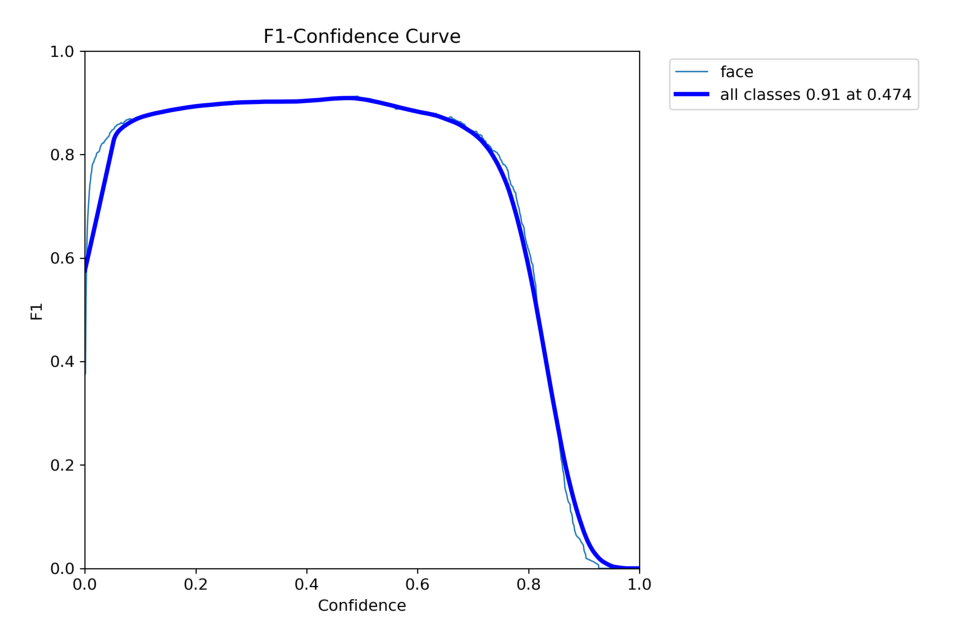

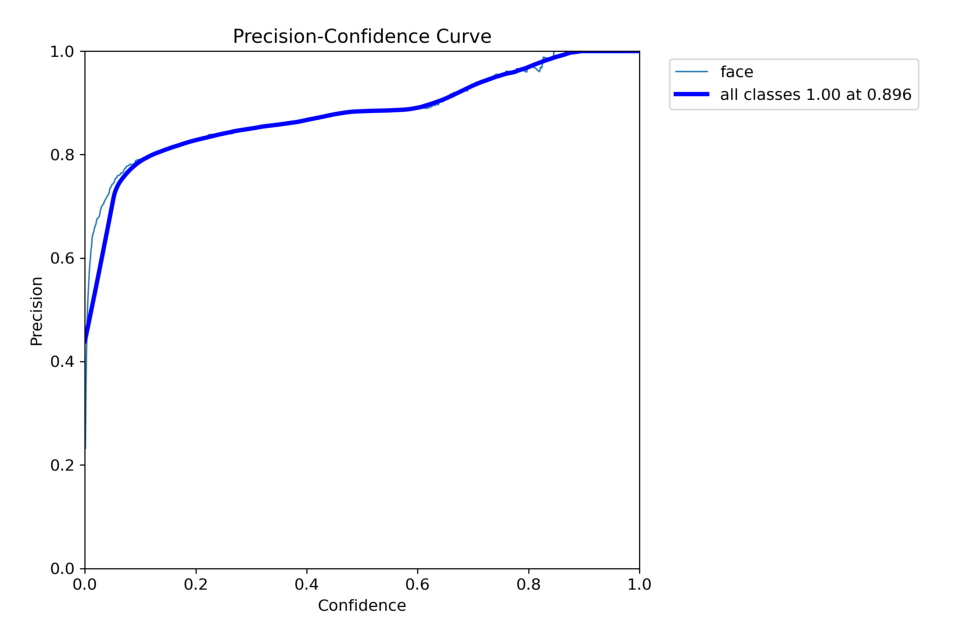

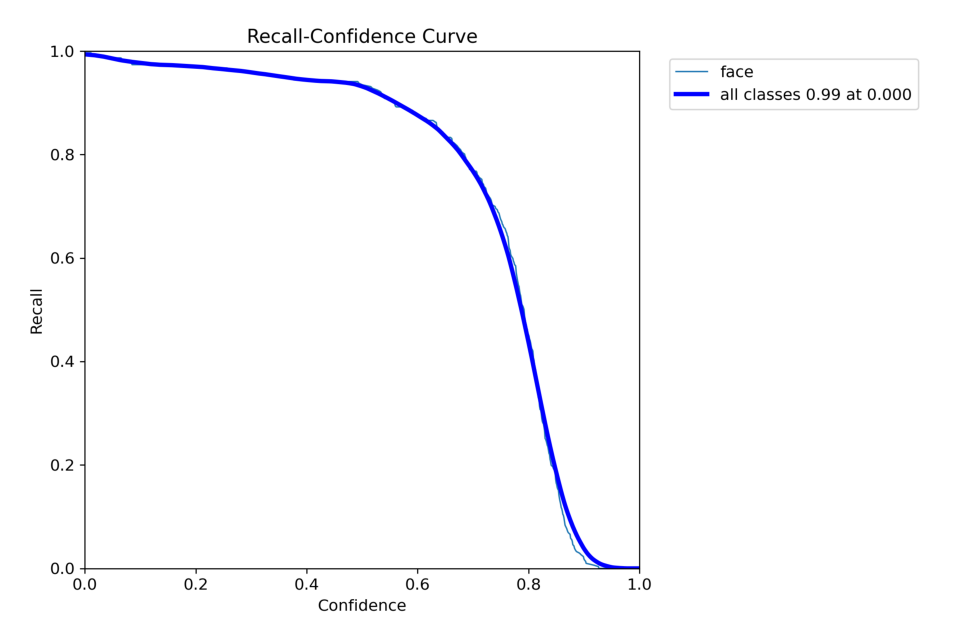

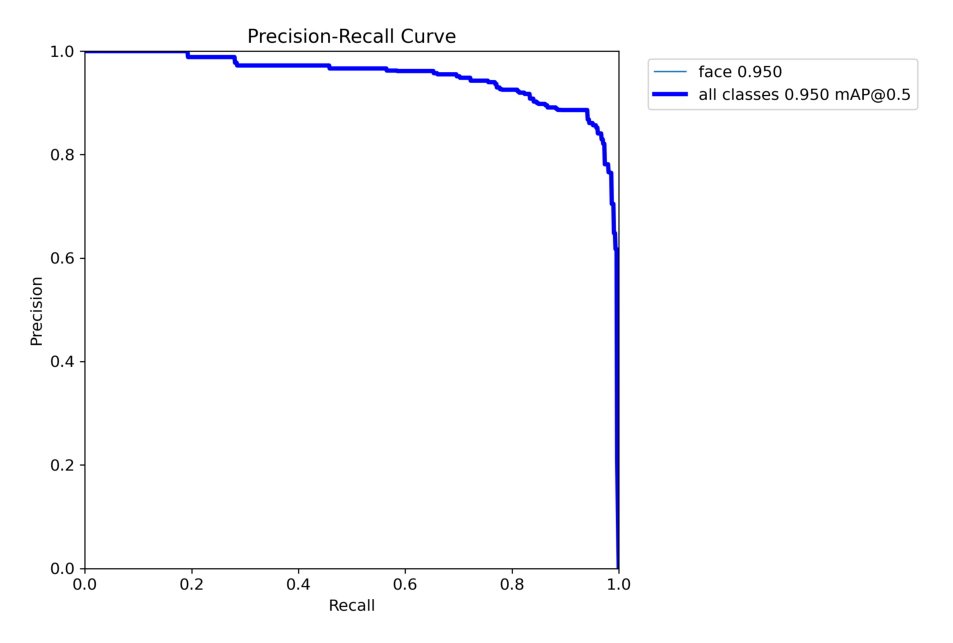

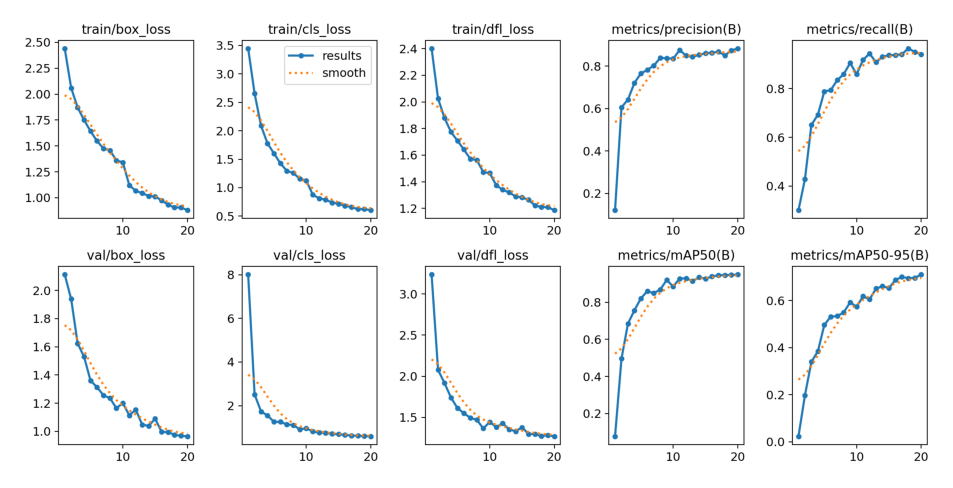

In [122]:
def display_images(post_training_files_path, image_files):

    for image_file in image_files:
        image_path = os.path.join(post_training_files_path, image_file)
        img = cv2.imread(image_path)

        if img is not None:
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

            plt.figure(figsize=(10, 10), dpi=120)
            plt.imshow(img)
            plt.axis('off')
            plt.show()
        else:
            print(f"Error: Could not load image from path: {image_path}")


image_files = [
    'F1_curve.png',
    'P_curve.png',
    'R_curve.png',
    'PR_curve.png',
    'results.png'
]

post_training_files_path = os.path.join(os.getcwd(), 'runs/detect/train2')
print(f"Attempting to load images from: {post_training_files_path}")

display_images(post_training_files_path, image_files)


image 1/1 /content/images/test/00001704.jpg: 640x640 1 face, 9.2ms
Speed: 2.3ms preprocess, 9.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


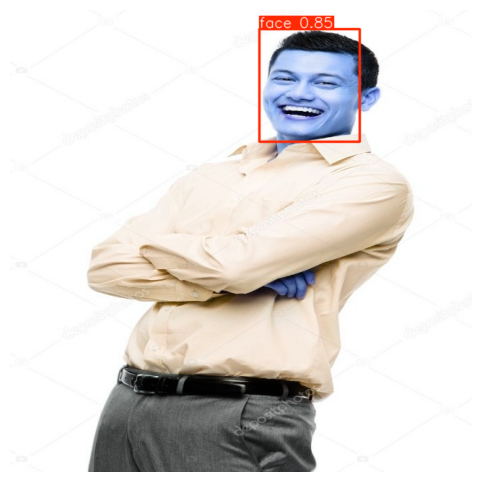


image 1/1 /content/images/test/00003471.jpg: 640x640 2 faces, 9.8ms
Speed: 3.3ms preprocess, 9.8ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


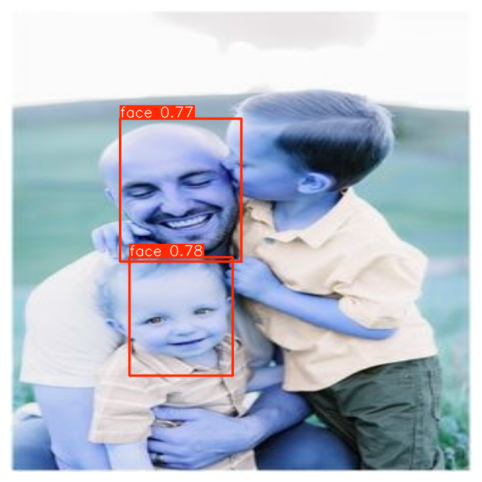


image 1/1 /content/images/test/00001073.jpg: 640x640 1 face, 10.2ms
Speed: 3.6ms preprocess, 10.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


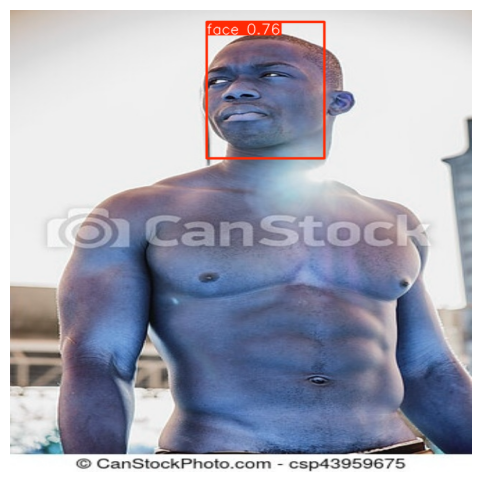


image 1/1 /content/images/test/00001399.jpg: 640x640 1 face, 10.6ms
Speed: 2.8ms preprocess, 10.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


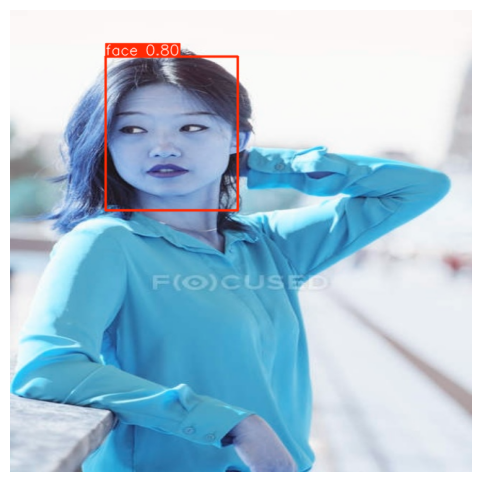


image 1/1 /content/images/test/00003072.jpg: 640x640 4 faces, 8.8ms
Speed: 2.3ms preprocess, 8.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


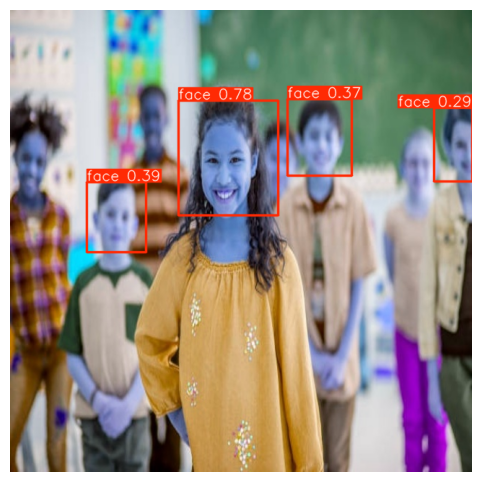


image 1/1 /content/images/test/00000024.jpg: 640x640 2 faces, 9.1ms
Speed: 2.9ms preprocess, 9.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


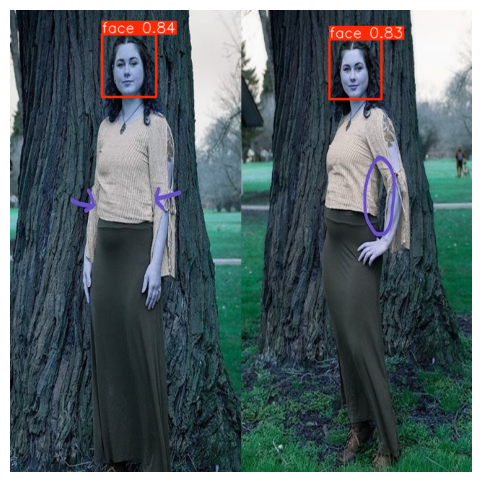


image 1/1 /content/images/test/00000834.jpg: 640x640 1 face, 10.4ms
Speed: 3.2ms preprocess, 10.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


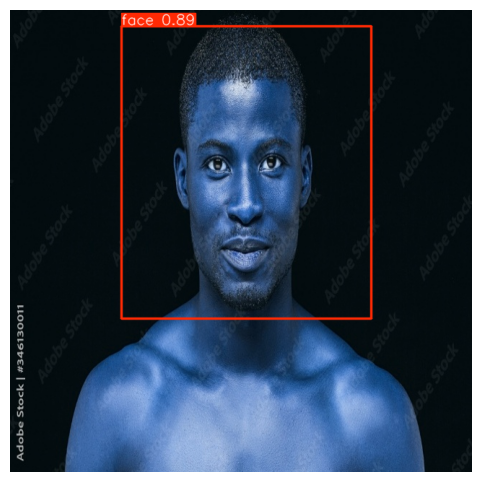


image 1/1 /content/images/test/00001251.jpg: 640x640 1 face, 9.4ms
Speed: 2.7ms preprocess, 9.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


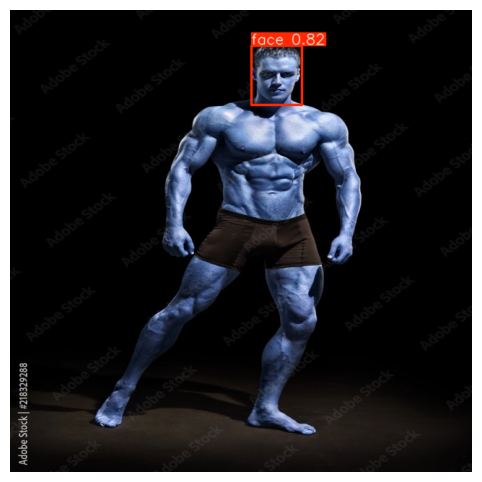


image 1/1 /content/images/test/00001072.jpg: 640x640 1 face, 10.1ms
Speed: 2.7ms preprocess, 10.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


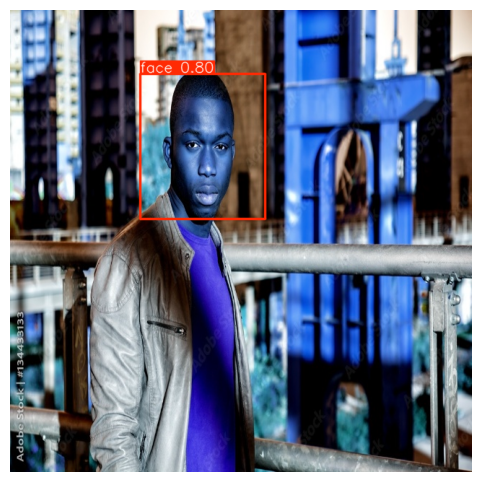


image 1/1 /content/images/test/00003311.jpg: 640x640 1 face, 10.2ms
Speed: 2.3ms preprocess, 10.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


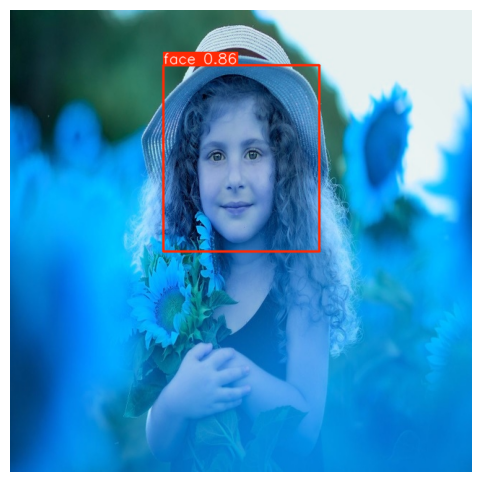


image 1/1 /content/images/test/00001557.jpg: 640x640 1 face, 11.8ms
Speed: 2.7ms preprocess, 11.8ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


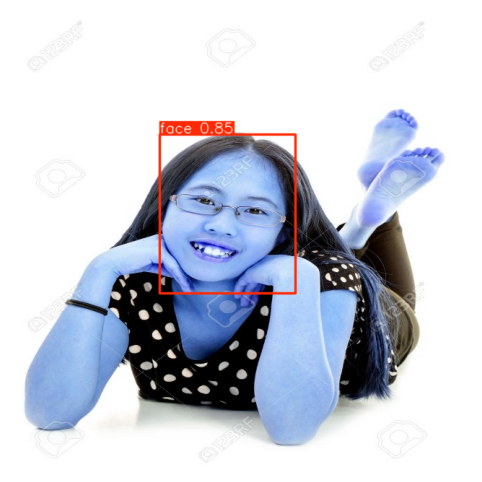


image 1/1 /content/images/test/00003104.jpg: 640x640 1 face, 10.2ms
Speed: 2.5ms preprocess, 10.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


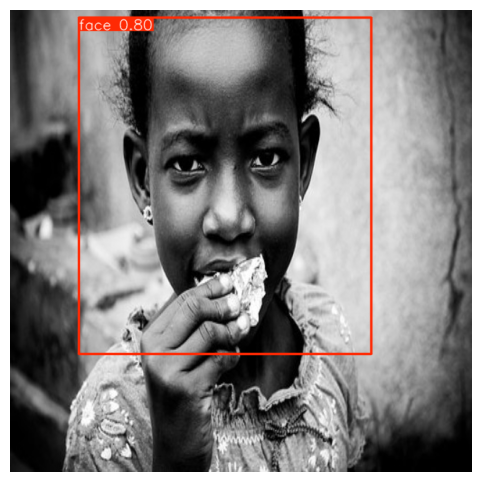


image 1/1 /content/images/test/00001013.jpg: 640x640 1 face, 9.4ms
Speed: 2.5ms preprocess, 9.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


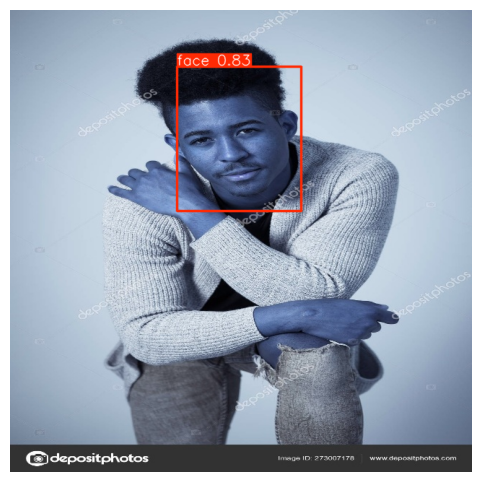


image 1/1 /content/images/test/00001753.jpg: 640x640 1 face, 12.7ms
Speed: 4.7ms preprocess, 12.7ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


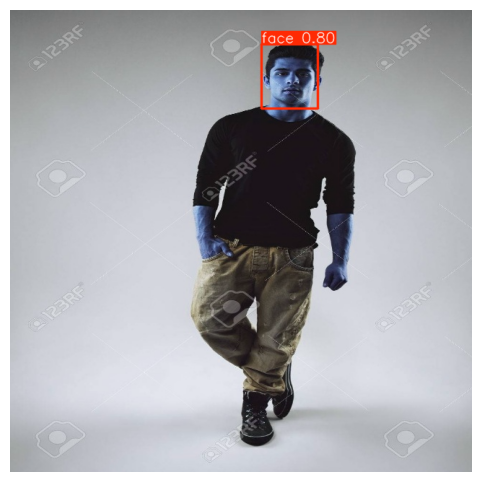


image 1/1 /content/images/test/00002965.jpg: 640x640 2 faces, 16.8ms
Speed: 2.6ms preprocess, 16.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


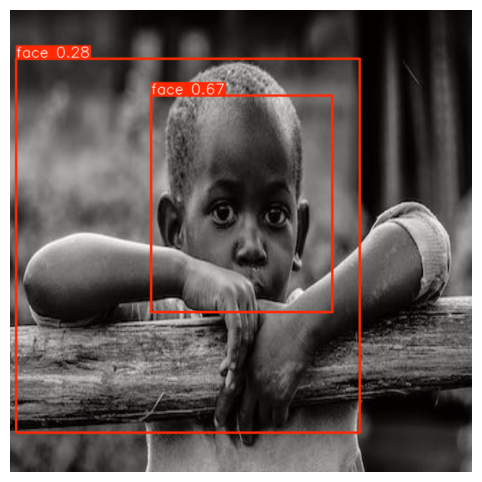


image 1/1 /content/images/test/00002772.jpg: 640x640 1 face, 8.6ms
Speed: 2.7ms preprocess, 8.6ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


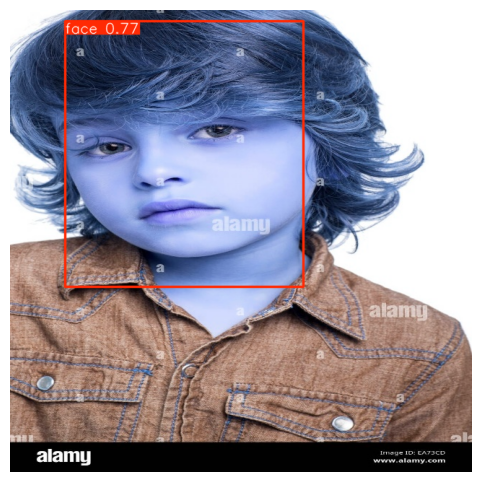


image 1/1 /content/images/test/00002178.jpg: 640x640 2 faces, 10.6ms
Speed: 2.7ms preprocess, 10.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


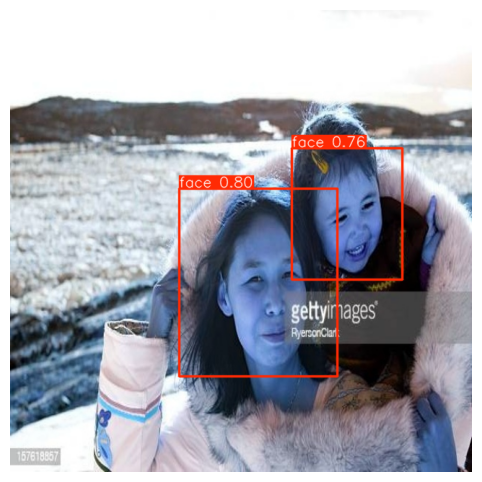


image 1/1 /content/images/test/00001032.jpg: 640x640 1 face, 11.2ms
Speed: 2.7ms preprocess, 11.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


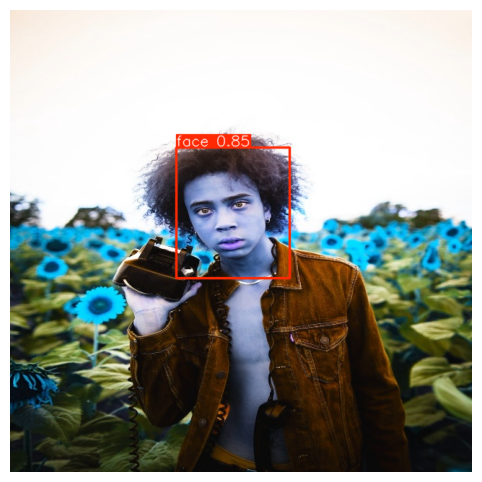


image 1/1 /content/images/test/00002436.jpg: 640x640 1 face, 11.1ms
Speed: 2.9ms preprocess, 11.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


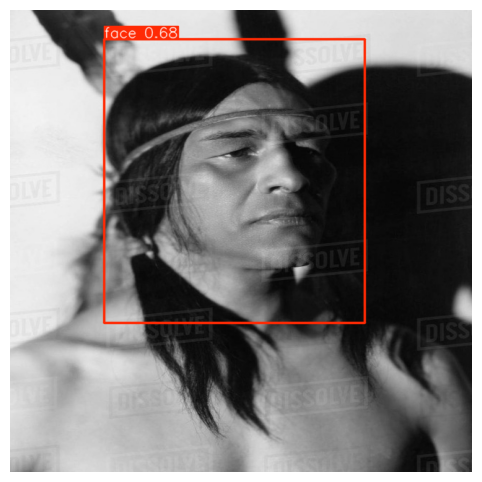


image 1/1 /content/images/test/00002687.jpg: 640x640 6 faces, 18.2ms
Speed: 2.6ms preprocess, 18.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


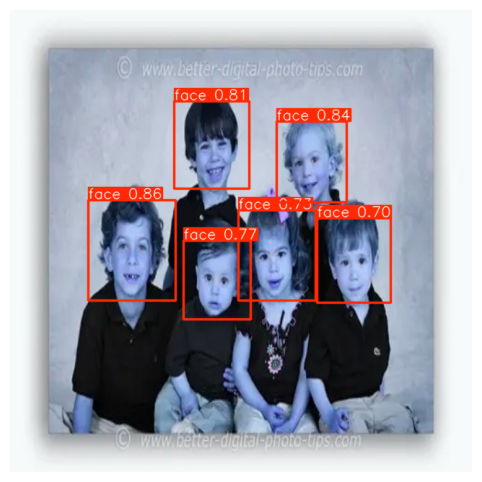


image 1/1 /content/images/test/00002095.jpg: 640x640 1 face, 8.4ms
Speed: 4.8ms preprocess, 8.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


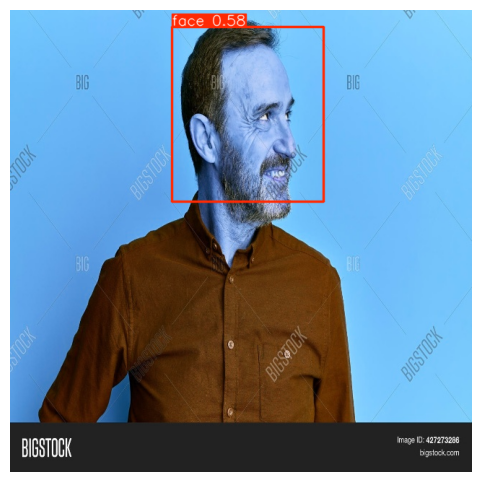


image 1/1 /content/images/test/00002911.jpg: 640x640 1 face, 9.7ms
Speed: 2.7ms preprocess, 9.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


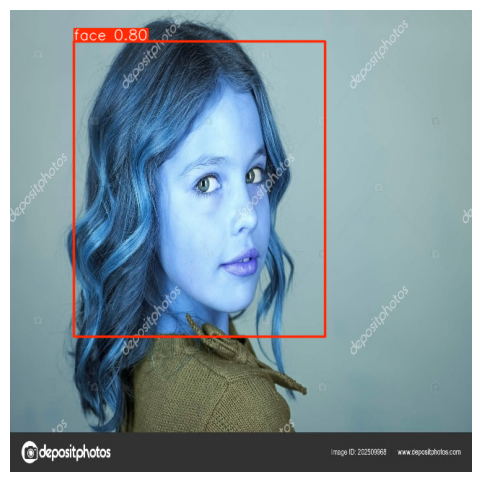


image 1/1 /content/images/test/00003020.jpg: 640x640 5 faces, 11.1ms
Speed: 2.7ms preprocess, 11.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


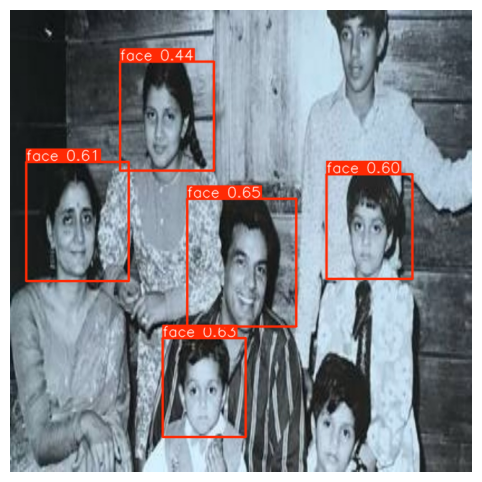


image 1/1 /content/images/test/00001284.jpg: 640x640 2 faces, 13.6ms
Speed: 2.8ms preprocess, 13.6ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)


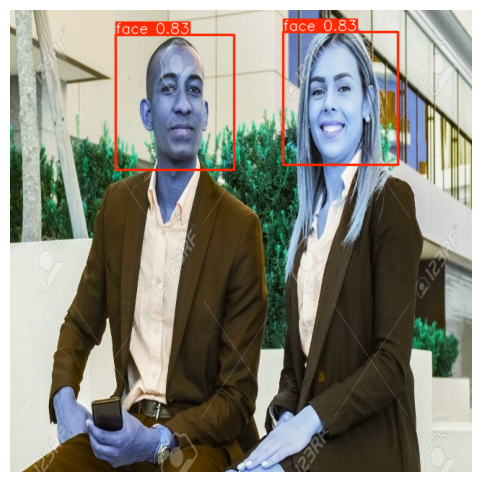


image 1/1 /content/images/test/00001222.jpg: 640x640 1 face, 13.1ms
Speed: 2.8ms preprocess, 13.1ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


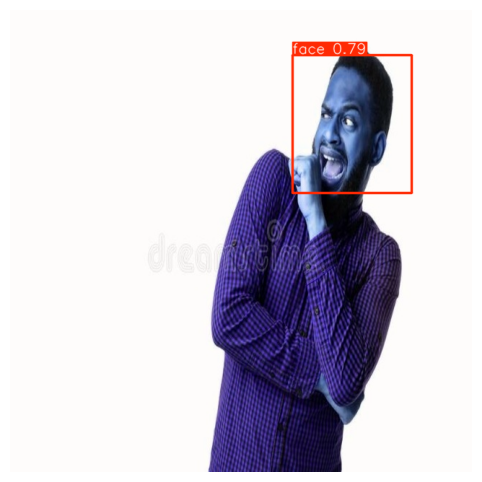


image 1/1 /content/images/test/00001732.jpg: 640x640 1 face, 11.3ms
Speed: 2.8ms preprocess, 11.3ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


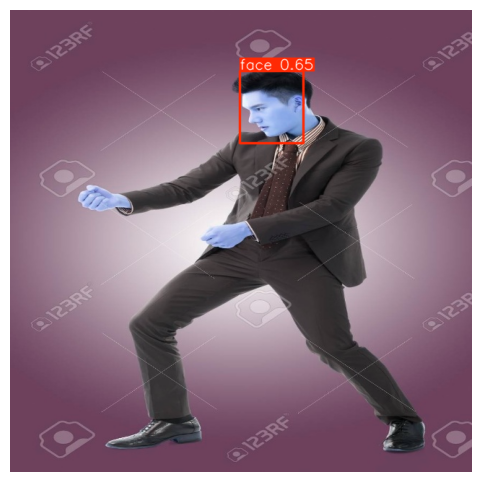


image 1/1 /content/images/test/00000381.jpg: 640x640 1 face, 13.3ms
Speed: 2.5ms preprocess, 13.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


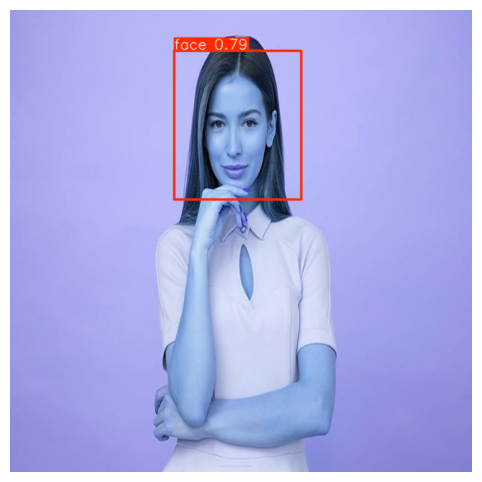


image 1/1 /content/images/test/00002827.jpg: 640x640 3 faces, 15.4ms
Speed: 2.8ms preprocess, 15.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


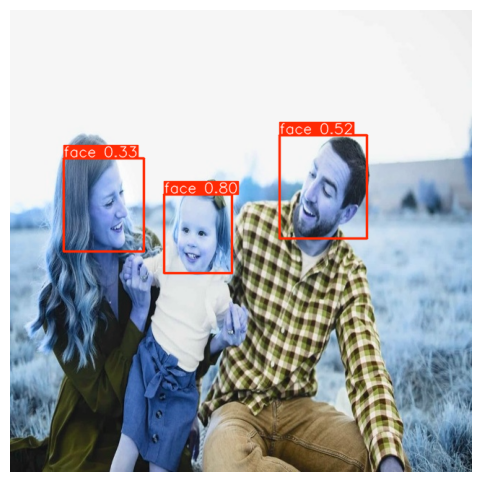


image 1/1 /content/images/test/00000362.jpg: 640x640 1 face, 15.1ms
Speed: 2.8ms preprocess, 15.1ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


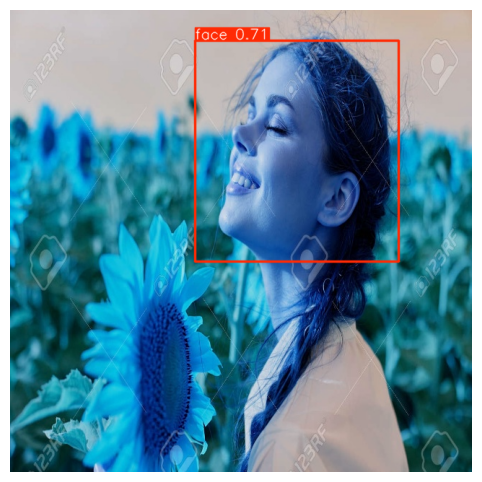


image 1/1 /content/images/test/00000847.jpg: 640x640 (no detections), 16.8ms
Speed: 2.7ms preprocess, 16.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


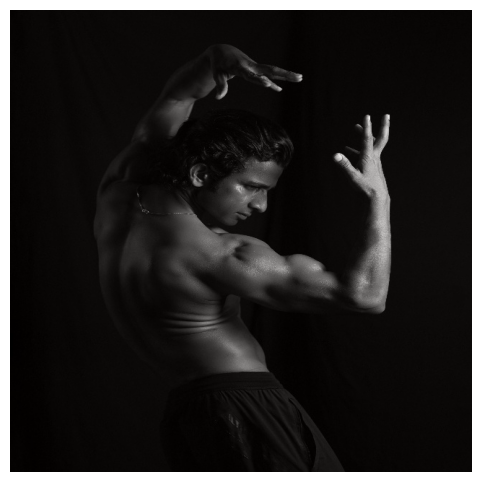


image 1/1 /content/images/test/00002269.jpg: 640x640 2 faces, 16.0ms
Speed: 2.8ms preprocess, 16.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


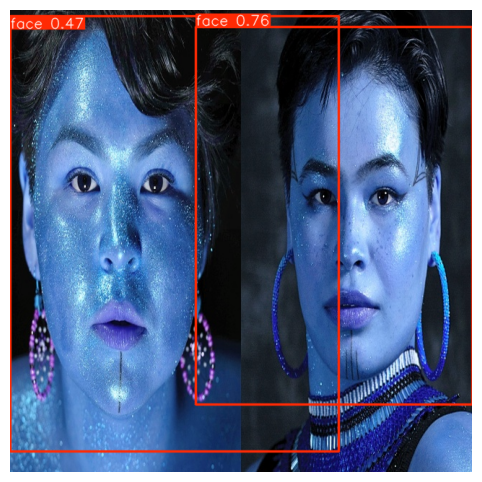


image 1/1 /content/images/test/00002548.jpg: 640x640 1 face, 12.0ms
Speed: 4.9ms preprocess, 12.0ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


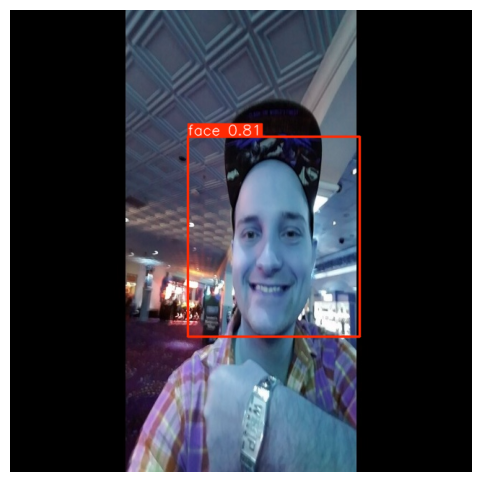


image 1/1 /content/images/test/00001752.jpg: 640x640 1 face, 15.5ms
Speed: 2.8ms preprocess, 15.5ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


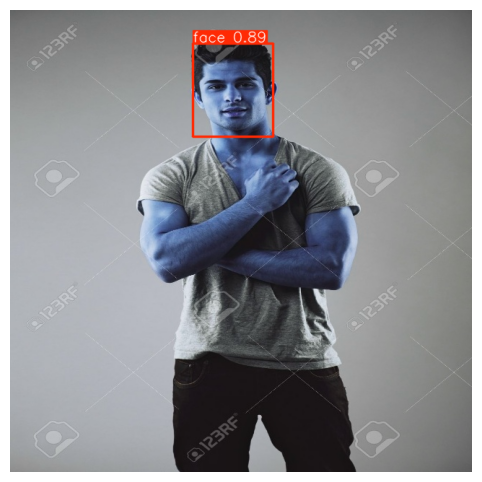


image 1/1 /content/images/test/00002229.jpg: 640x640 1 face, 10.3ms
Speed: 2.8ms preprocess, 10.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


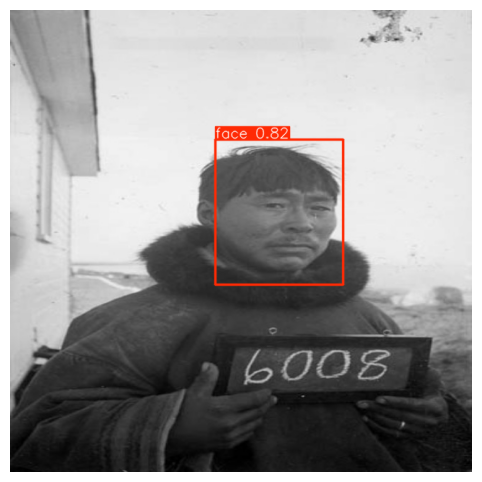


image 1/1 /content/images/test/00002209.jpg: 640x640 1 face, 13.8ms
Speed: 2.8ms preprocess, 13.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


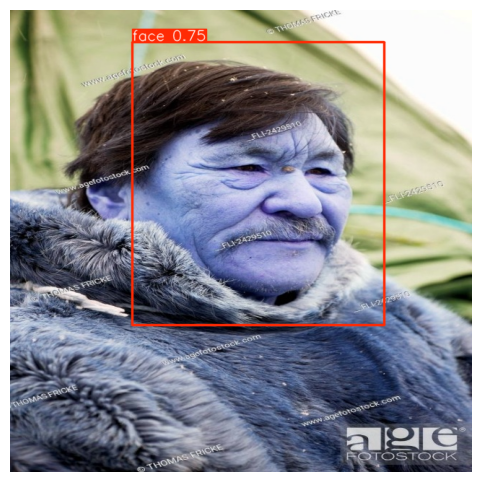


image 1/1 /content/images/test/00002669.jpg: 640x640 6 faces, 11.3ms
Speed: 3.6ms preprocess, 11.3ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


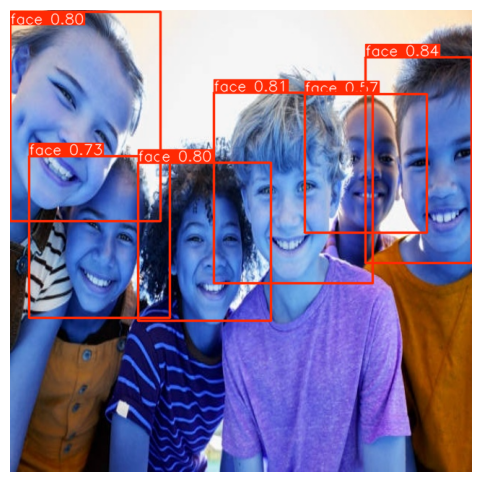


image 1/1 /content/images/test/00001965.jpg: 640x640 1 face, 9.5ms
Speed: 2.8ms preprocess, 9.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


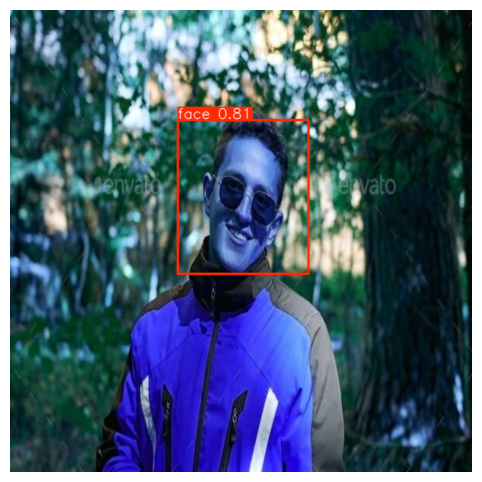


image 1/1 /content/images/test/00001436.jpg: 640x640 1 face, 15.5ms
Speed: 2.8ms preprocess, 15.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


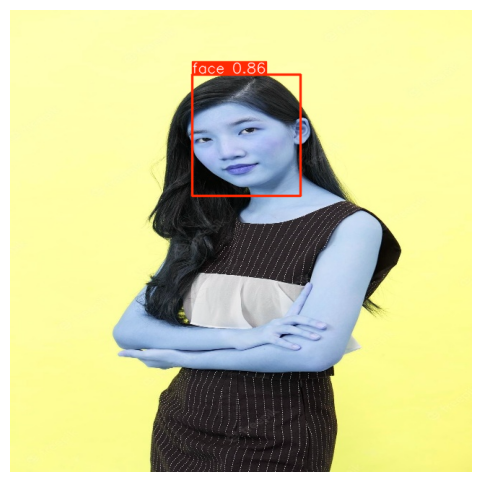


image 1/1 /content/images/test/00001743.jpg: 640x640 1 face, 9.5ms
Speed: 2.5ms preprocess, 9.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


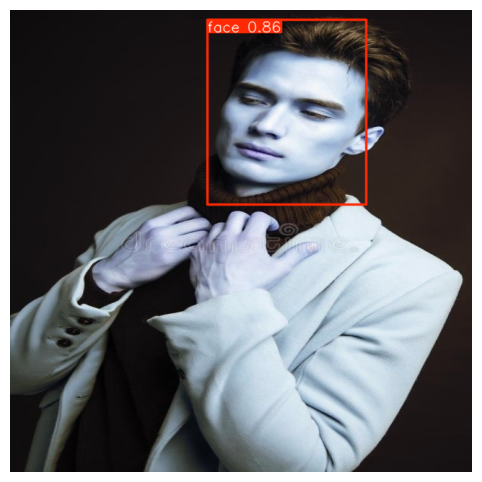


image 1/1 /content/images/test/00000308.jpg: 640x640 1 face, 13.1ms
Speed: 3.0ms preprocess, 13.1ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


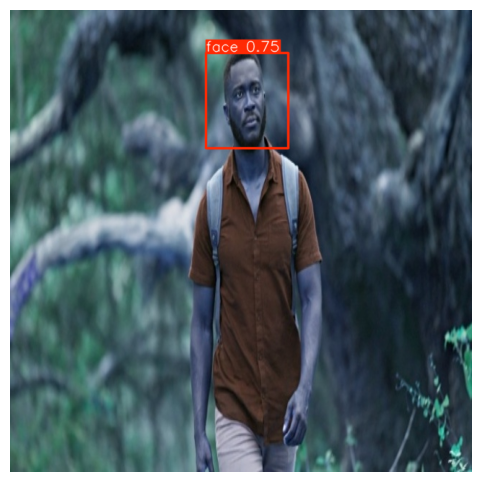


image 1/1 /content/images/test/00002678.jpg: 640x640 2 faces, 12.8ms
Speed: 2.6ms preprocess, 12.8ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


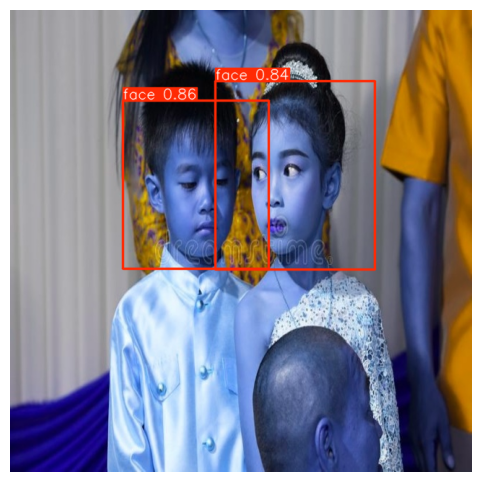


image 1/1 /content/images/test/00001541.jpg: 640x640 2 faces, 12.6ms
Speed: 3.8ms preprocess, 12.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


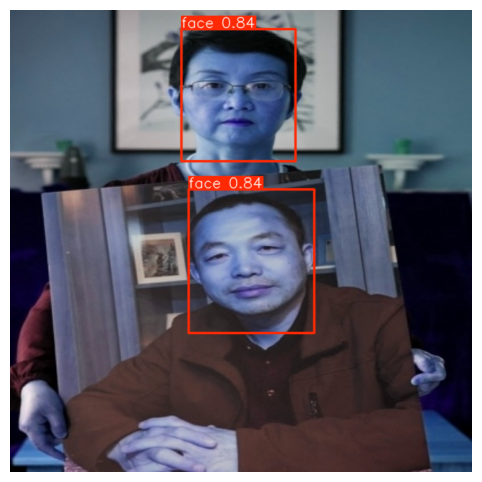


image 1/1 /content/images/test/00000717.jpg: 640x640 5 faces, 11.2ms
Speed: 2.7ms preprocess, 11.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


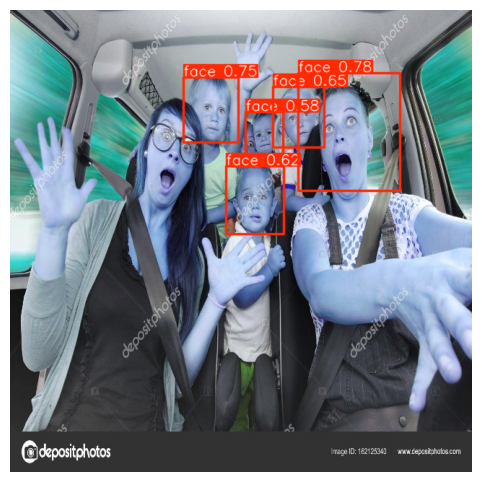


image 1/1 /content/images/test/00001270.jpg: 640x640 1 face, 9.5ms
Speed: 2.6ms preprocess, 9.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


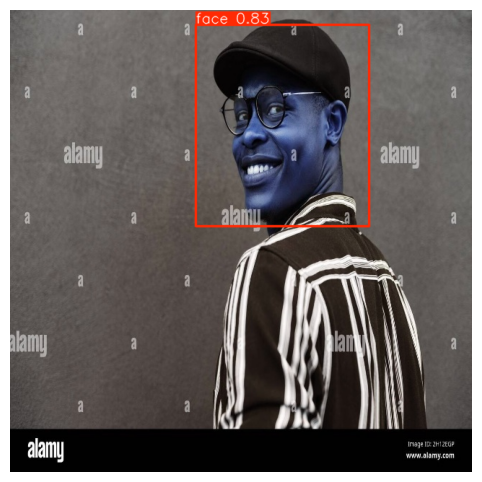


image 1/1 /content/images/test/00003142.jpg: 640x640 1 face, 8.8ms
Speed: 2.9ms preprocess, 8.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


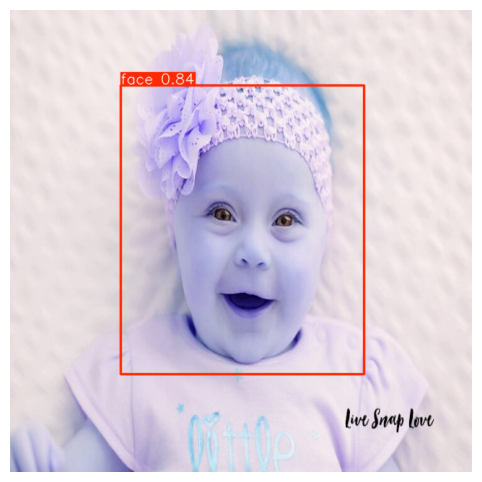


image 1/1 /content/images/test/00000396.jpg: 640x640 1 face, 8.7ms
Speed: 2.5ms preprocess, 8.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


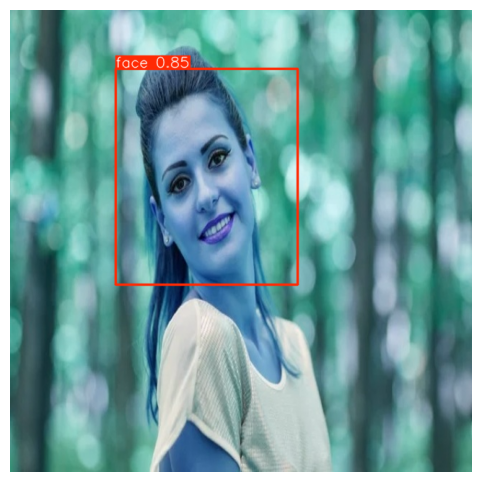


image 1/1 /content/images/test/00000206.jpg: 640x640 1 face, 17.0ms
Speed: 2.7ms preprocess, 17.0ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


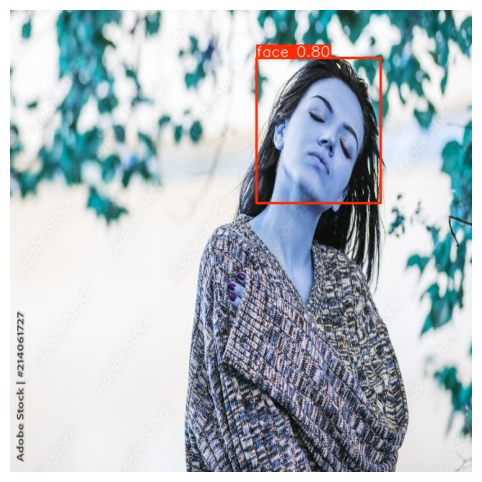


image 1/1 /content/images/test/00002212.jpg: 640x640 1 face, 12.9ms
Speed: 2.8ms preprocess, 12.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


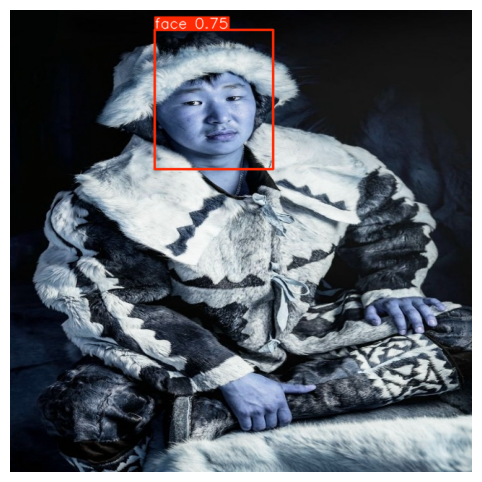


image 1/1 /content/images/test/00000532.jpg: 640x640 6 faces, 13.9ms
Speed: 3.0ms preprocess, 13.9ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


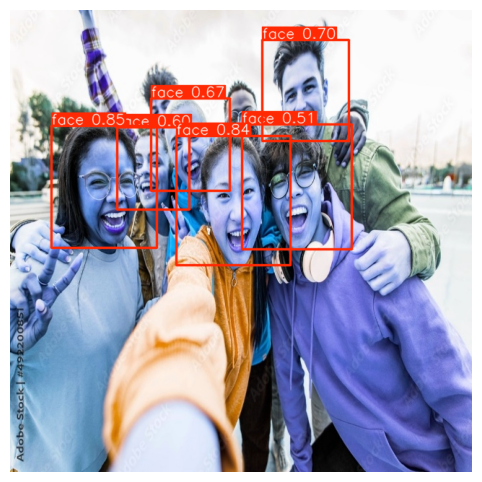


image 1/1 /content/images/test/00001549.jpg: 640x640 1 face, 11.8ms
Speed: 2.6ms preprocess, 11.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


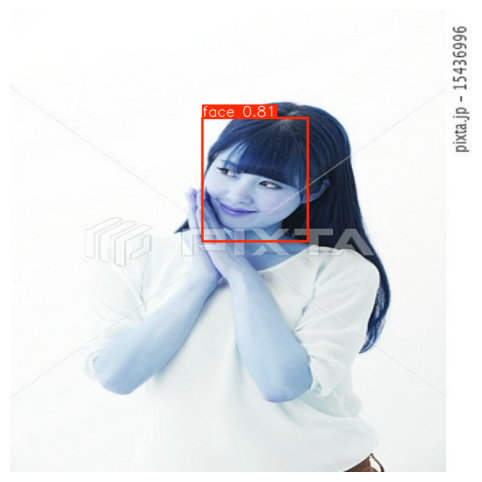

In [124]:
image_dir = "/content/images/test"

all_images = os.listdir(image_dir)
selected_images = all_images[:50]

for img_name in selected_images:
    img_path = os.path.join(image_dir, img_name)
    results = model.predict(img_path)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    for result in results:
        plotted_img = result.plot()
        plt.figure(figsize=(8, 6))
        plt.imshow(plotted_img)
        plt.axis('off')
        plt.show()


image 1/1 /content/drivingLicense/driving_license_52.png: 512x640 1 face, 14.1ms
Speed: 4.1ms preprocess, 14.1ms inference, 2.9ms postprocess per image at shape (1, 3, 512, 640)


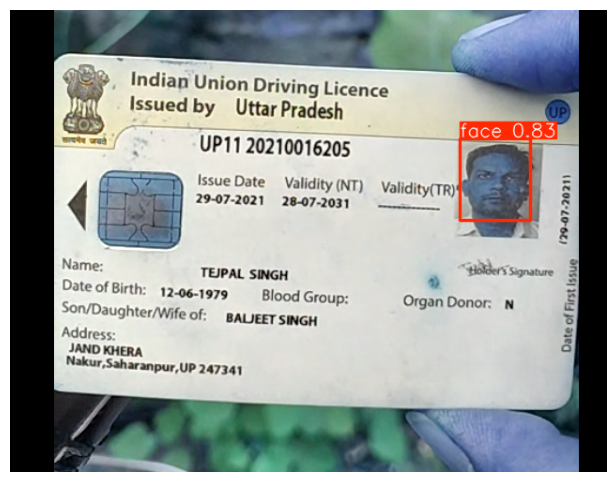


image 1/1 /content/drivingLicense/driving_license_46.png: 448x640 1 face, 17.1ms
Speed: 3.2ms preprocess, 17.1ms inference, 5.4ms postprocess per image at shape (1, 3, 448, 640)


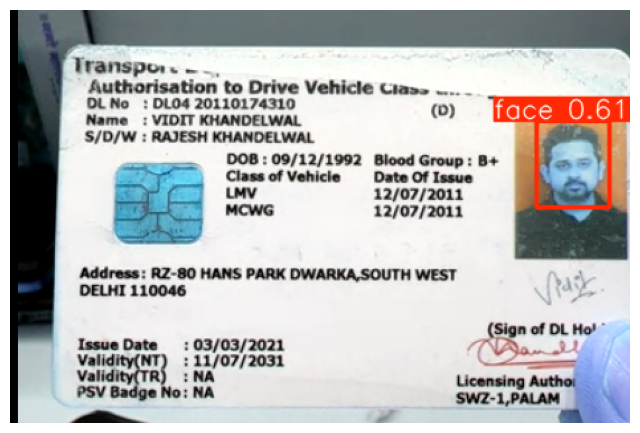


image 1/1 /content/drivingLicense/driving_license_44.png: 640x480 (no detections), 13.0ms
Speed: 2.0ms preprocess, 13.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 480)


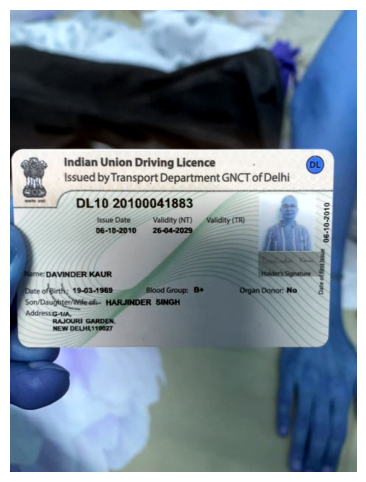


image 1/1 /content/drivingLicense/driving_license_47.png: 640x480 (no detections), 10.7ms
Speed: 2.1ms preprocess, 10.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)


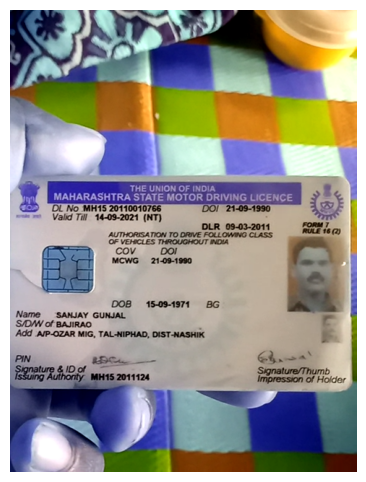


image 1/1 /content/drivingLicense/driving_license_37.png: 512x640 2 faces, 8.5ms
Speed: 3.4ms preprocess, 8.5ms inference, 1.9ms postprocess per image at shape (1, 3, 512, 640)


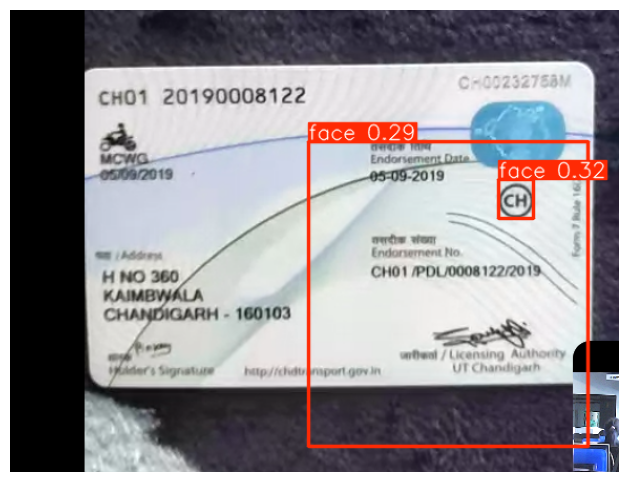


image 1/1 /content/drivingLicense/driving_license_42.png: 640x480 1 face, 10.3ms
Speed: 2.0ms preprocess, 10.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 480)


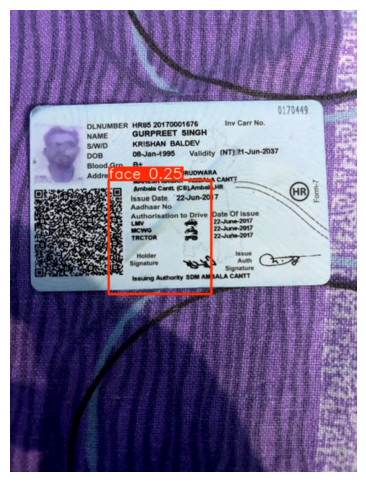


image 1/1 /content/drivingLicense/driving_license_43.png: 640x480 1 face, 9.9ms
Speed: 2.0ms preprocess, 9.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)


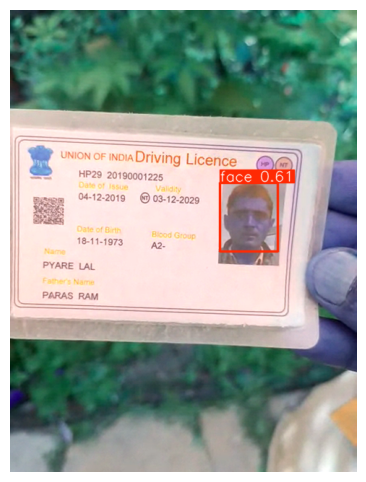


image 1/1 /content/drivingLicense/driving_license_50.png: 448x640 1 face, 8.8ms
Speed: 3.0ms preprocess, 8.8ms inference, 1.9ms postprocess per image at shape (1, 3, 448, 640)


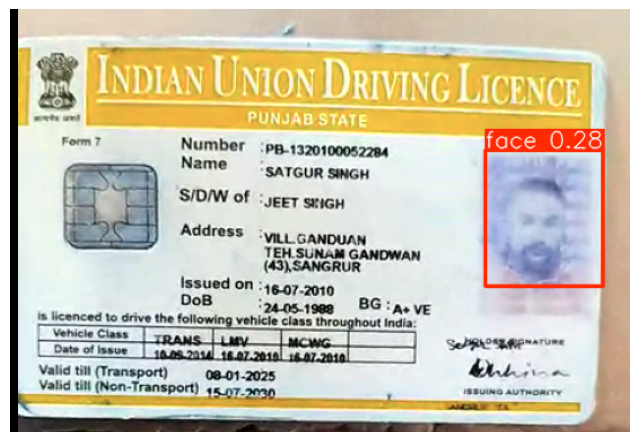


image 1/1 /content/drivingLicense/driving_license_38.png: 544x640 1 face, 12.7ms
Speed: 3.6ms preprocess, 12.7ms inference, 2.4ms postprocess per image at shape (1, 3, 544, 640)


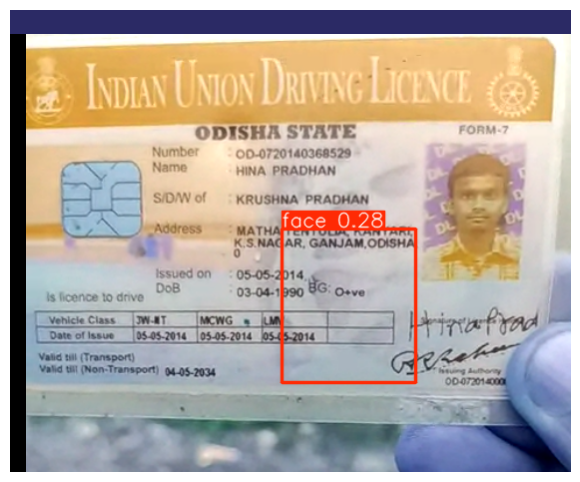


image 1/1 /content/drivingLicense/driving_license_53.png: 448x640 1 face, 22.3ms
Speed: 6.8ms preprocess, 22.3ms inference, 6.6ms postprocess per image at shape (1, 3, 448, 640)


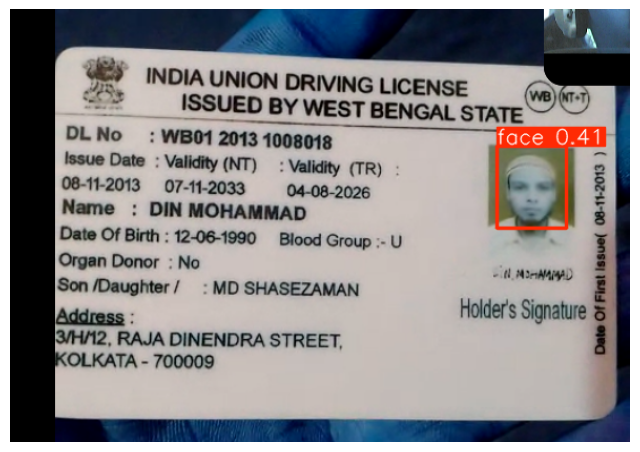


image 1/1 /content/drivingLicense/driving_license_48.jpg: 640x480 1 face, 31.4ms
Speed: 5.8ms preprocess, 31.4ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 480)


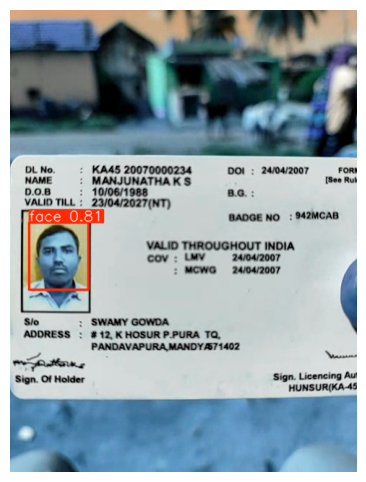


image 1/1 /content/drivingLicense/driving_license_36.png: 544x640 1 face, 13.0ms
Speed: 7.9ms preprocess, 13.0ms inference, 2.0ms postprocess per image at shape (1, 3, 544, 640)


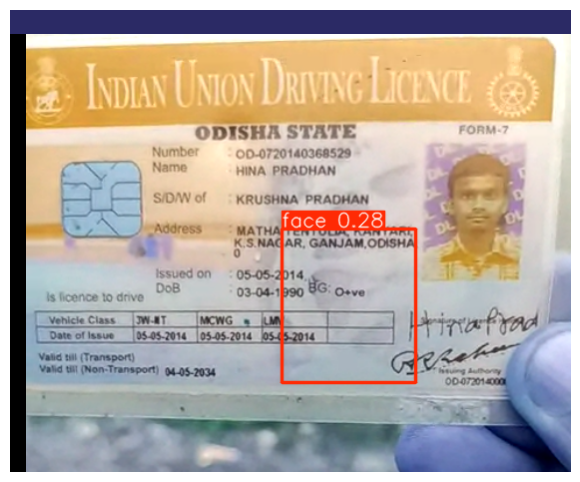


image 1/1 /content/drivingLicense/driving_license_34.png: 448x640 (no detections), 12.8ms
Speed: 2.9ms preprocess, 12.8ms inference, 0.9ms postprocess per image at shape (1, 3, 448, 640)


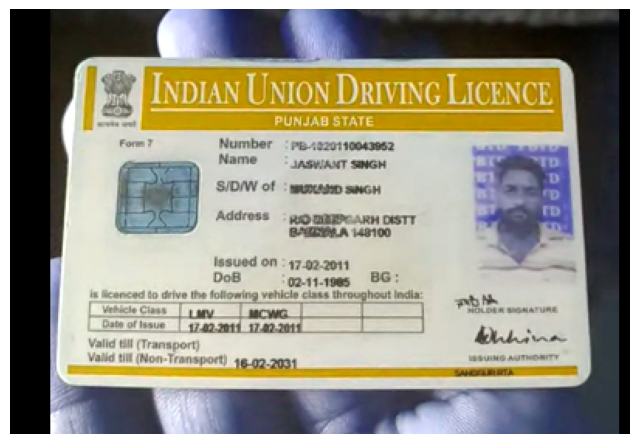


image 1/1 /content/drivingLicense/driving_license_51.png: 512x640 1 face, 12.0ms
Speed: 3.5ms preprocess, 12.0ms inference, 3.3ms postprocess per image at shape (1, 3, 512, 640)


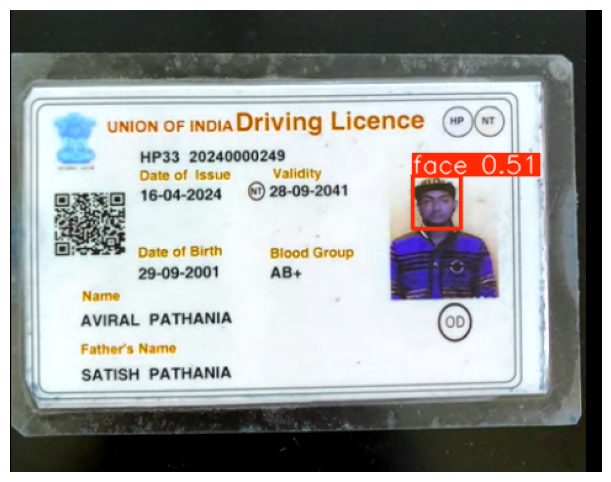


image 1/1 /content/drivingLicense/driving_license_40.png: 640x480 1 face, 11.3ms
Speed: 2.0ms preprocess, 11.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 480)


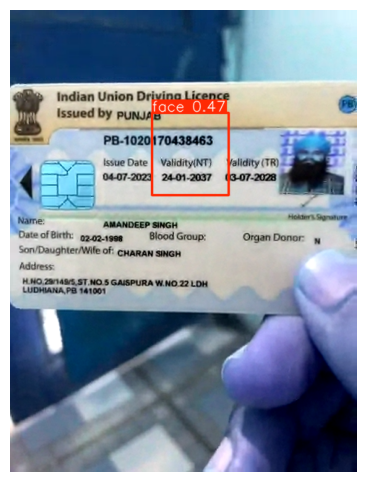


image 1/1 /content/drivingLicense/driving_license_49.png: 640x480 1 face, 10.3ms
Speed: 2.0ms preprocess, 10.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 480)


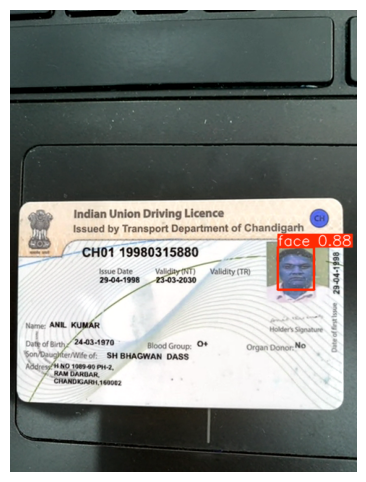


image 1/1 /content/drivingLicense/driving_license_54.png: 448x640 1 face, 9.5ms
Speed: 3.2ms preprocess, 9.5ms inference, 1.8ms postprocess per image at shape (1, 3, 448, 640)


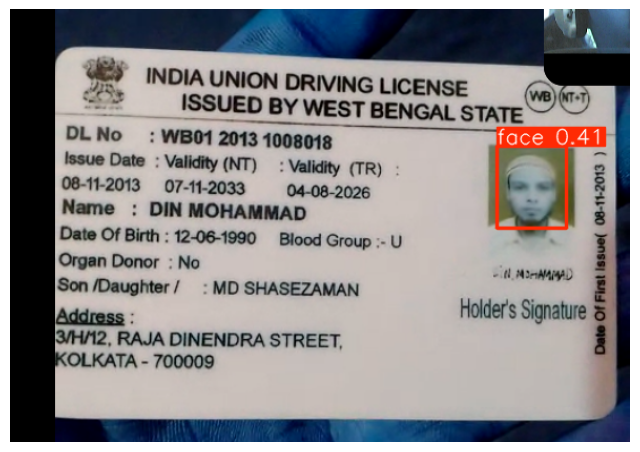


image 1/1 /content/drivingLicense/driving_license_35.png: 416x640 1 face, 9.7ms
Speed: 3.1ms preprocess, 9.7ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 640)


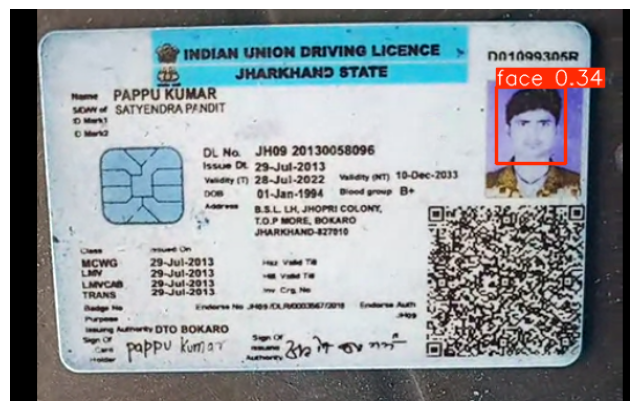


image 1/1 /content/drivingLicense/driving_license_39.png: 480x640 1 face, 9.6ms
Speed: 3.5ms preprocess, 9.6ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)


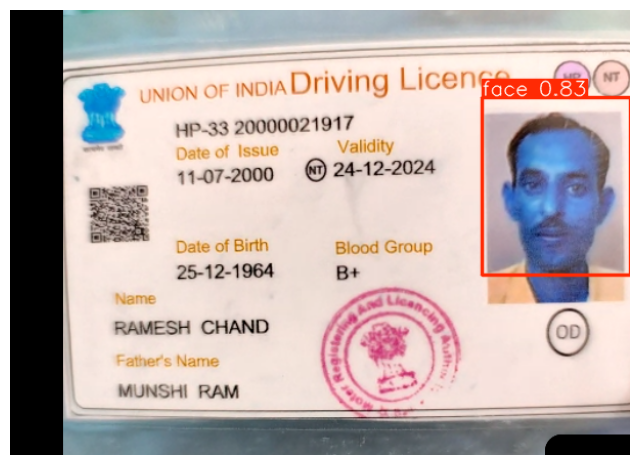


image 1/1 /content/drivingLicense/driving_license_41.png: 640x480 (no detections), 10.8ms
Speed: 1.8ms preprocess, 10.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 480)


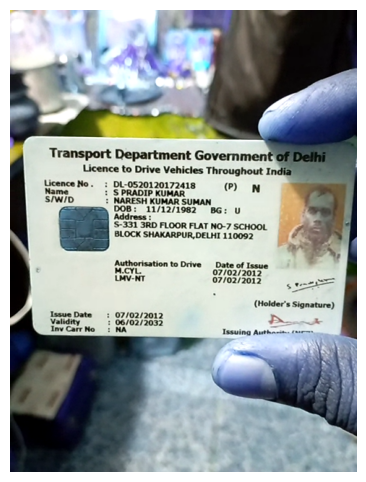


image 1/1 /content/drivingLicense/driving_license_45.png: 480x640 1 face, 14.2ms
Speed: 7.5ms preprocess, 14.2ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


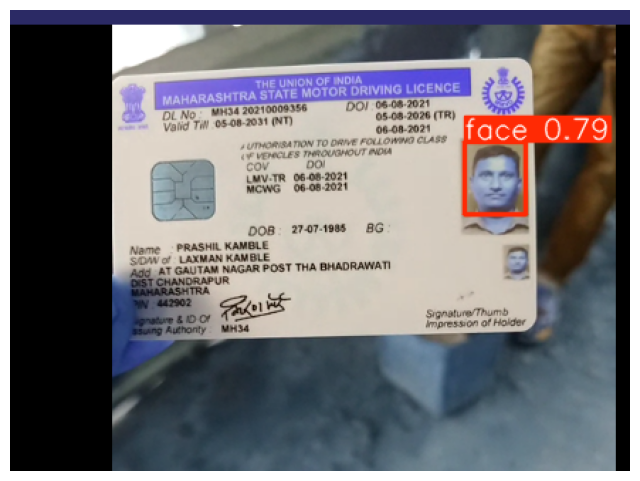

In [132]:
image_dir = "/content/drivingLicense"

all_images = os.listdir(image_dir)
selected_images = all_images[:50]

for img_name in selected_images:
    img_path = os.path.join(image_dir, img_name)
    results = model.predict(img_path)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    for result in results:
        plotted_img = result.plot()
        plt.figure(figsize=(8, 6))
        plt.imshow(plotted_img)
        plt.axis('off')
        plt.show()

In [126]:
import os
cropped_output_folder = "/content/cropped_face"
os.makedirs(cropped_output_folder, exist_ok=True)

image_dir = "/content/drivingLicense"
all_images = os.listdir(image_dir)
selected_images = all_images[:50]

for img_name in selected_images:
    img_path = os.path.join(image_dir, img_name)
    results = model.predict(img_path)[0]  # [0] to access first image result

    # Load original image
    image = cv2.imread(img_path)

    for i, box in enumerate(results.boxes.xyxy):
        x1, y1, x2, y2 = map(int, box.cpu().numpy())
        cropped = image[y1:y2, x1:x2]

        # Build output path
        base_name = os.path.splitext(img_name)[0]
        save_name = f"{base_name}_cropped_{i+1}.jpg"  # Handles multiple faces
        save_path = os.path.join(cropped_output_folder, save_name)

        cv2.imwrite(save_path, cropped)



image 1/1 /content/drivingLicense/driving_license_52.png: 512x640 1 face, 8.4ms
Speed: 2.9ms preprocess, 8.4ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)

image 1/1 /content/drivingLicense/driving_license_46.png: 448x640 1 face, 7.3ms
Speed: 2.3ms preprocess, 7.3ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)

image 1/1 /content/drivingLicense/driving_license_44.png: 640x480 (no detections), 6.9ms
Speed: 1.4ms preprocess, 6.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/drivingLicense/driving_license_47.png: 640x480 (no detections), 11.1ms
Speed: 1.9ms preprocess, 11.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/drivingLicense/driving_license_37.png: 512x640 2 faces, 7.2ms
Speed: 2.3ms preprocess, 7.2ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)

image 1/1 /content/drivingLicense/driving_license_42.png: 640x480 1 face, 7.1ms
Speed: 1.4ms 

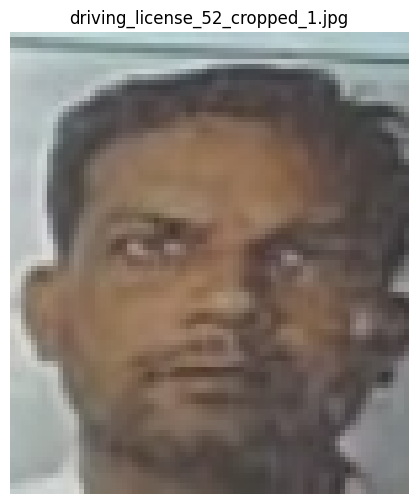

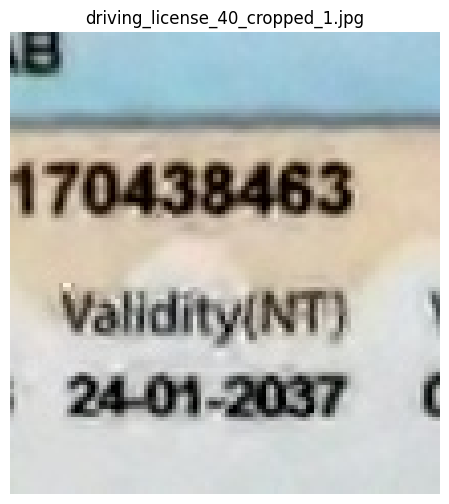

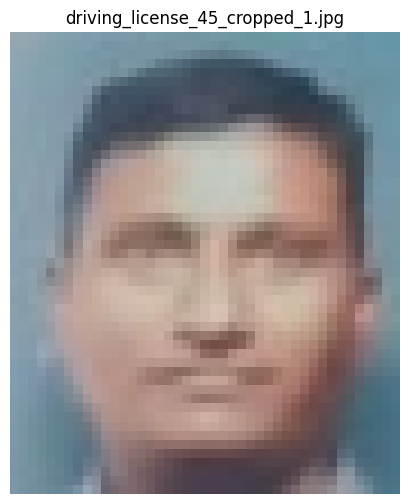

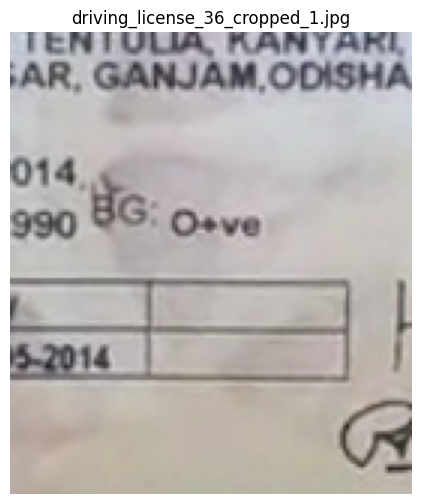

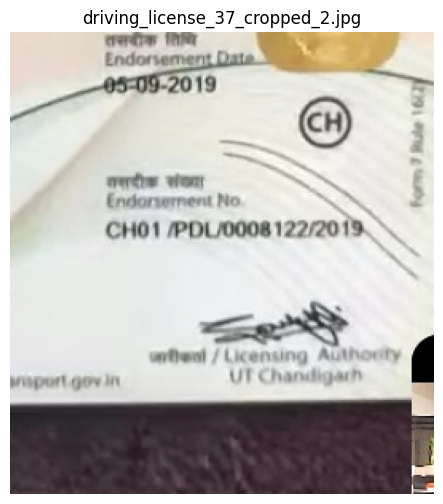

...

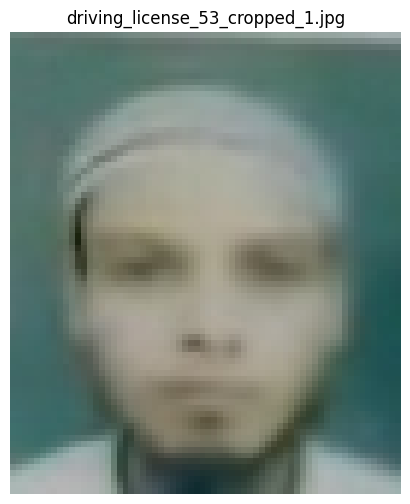

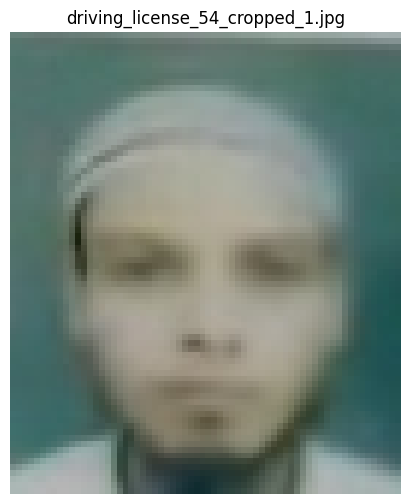

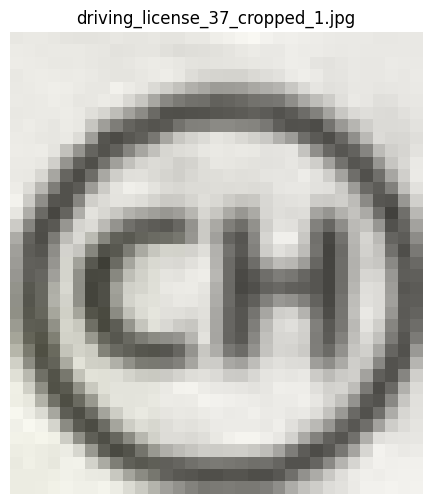

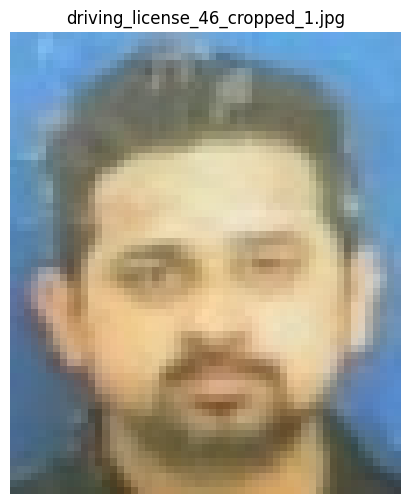

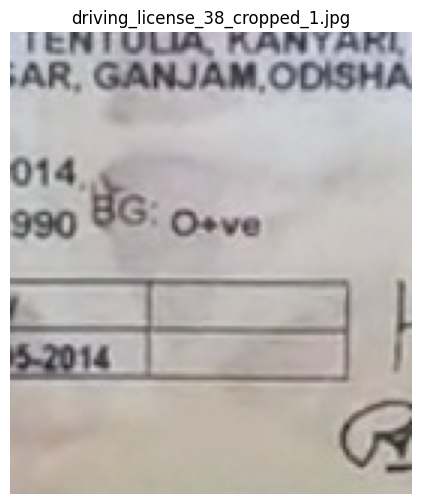

In [130]:
import matplotlib.pyplot as plt
cropped_faces_folder = "/content/cropped_face"
cropped_face_files = [f for f in os.listdir(cropped_faces_folder) if f.endswith(('.jpg', '.jpeg', '.png'))]

for img_file in cropped_face_files:
    img_path = os.path.join(cropped_faces_folder, img_file)

    try:
        img = cv2.imread(img_path)

        if img is not None:
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            plt.figure(figsize=(6, 6))
            plt.imshow(img_rgb)
            plt.title(img_file)
            plt.axis('off')
            plt.show()
        else:
            print(f"Warning: Could not read image file: {img_file}")

    except Exception as e:
        print(f"Error displaying image {img_file}: {e}")

In [131]:
!zip -r /content/cropped_face.zip /content/cropped_face
from google.colab import files
files.download('/content/cropped_face.zip')

  adding: content/cropped_face/ (stored 0%)
  adding: content/cropped_face/driving_license_52_cropped_1.jpg (deflated 5%)
  adding: content/cropped_face/driving_license_40_cropped_1.jpg (deflated 3%)
  adding: content/cropped_face/driving_license_45_cropped_1.jpg (deflated 9%)
  adding: content/cropped_face/driving_license_36_cropped_1.jpg (deflated 2%)
  adding: content/cropped_face/driving_license_37_cropped_2.jpg (deflated 1%)
  adding: content/cropped_face/driving_license_43_cropped_1.jpg (deflated 5%)
  adding: content/cropped_face/driving_license_39_cropped_1.jpg (deflated 2%)
  adding: content/cropped_face/driving_license_48_cropped_1.jpg (deflated 4%)
  adding: content/cropped_face/driving_license_51_cropped_1.jpg (deflated 10%)
  adding: content/cropped_face/driving_license_42_cropped_1.jpg (deflated 2%)
  adding: content/cropped_face/driving_license_50_cropped_1.jpg (deflated 4%)
  adding: content/cropped_face/driving_license_49_cropped_1.jpg (deflated 7%)
  adding: content/c

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>